## Visualization of Semantic Networks 

-  Bryce Johnson 
-  CS 841 

This is the code for visualizing networks using some out-of-the box techniques that are available through networkx and using a popular manifold discovery algorithm UMAP. 

In [2]:
import networkx as nx 
import pickle
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from tqdm import tqdm
import umap
import os

### Simple Visualizations 

We start out here just by visulazing with the defaults for all AD patients.

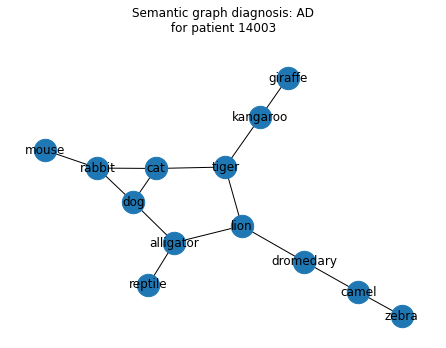

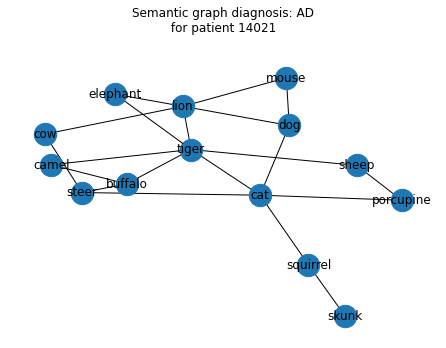

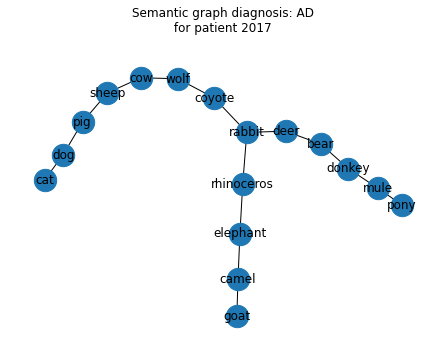

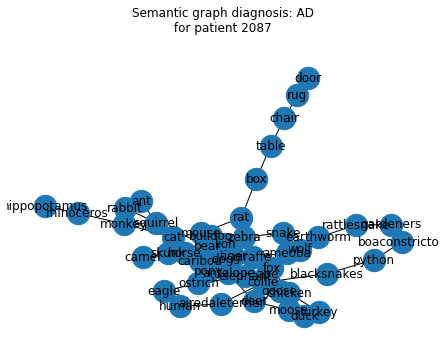

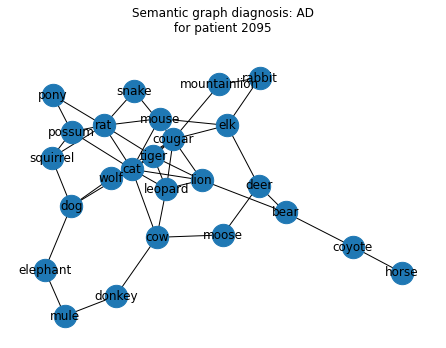

...

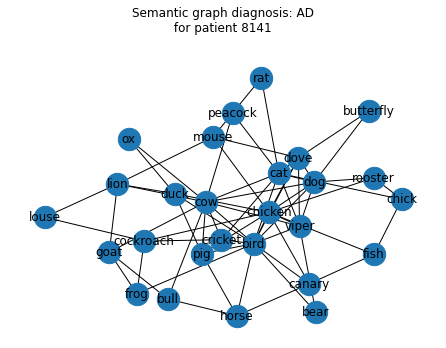

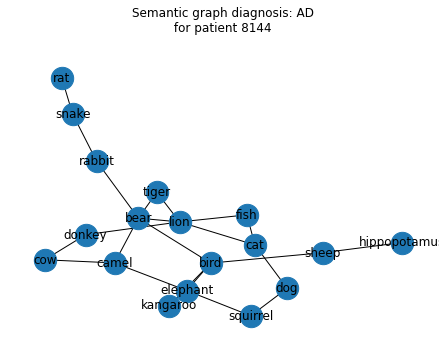

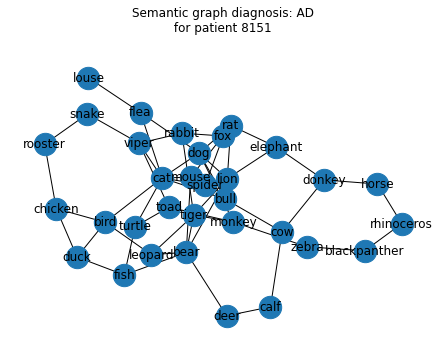

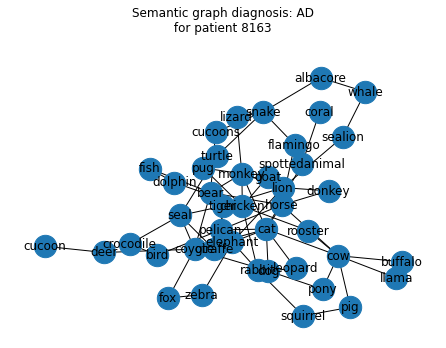

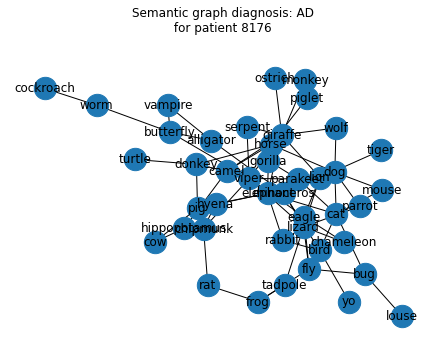

In [3]:
########### so its just in that all these graphs are AD no matter what############ 
with open(os.path.join('dataCS841','ucsd_nc_graphs_usf_persev.pickle'), 'rb') as f:
    data_nc = pickle.load(f,encoding='latin1')
    df_nc=pd.DataFrame(data_nc)
    df_nc['diagnosis']='NC'
with open(os.path.join('dataCS841','ucsd_ad_graphs_usf_persev.pickle'), 'rb') as f:
    data_ad = pickle.load(f,encoding='latin1')
    df_ad=pd.DataFrame(data_ad)
    df_ad['diagnosis']='AD'
assert len(df_ad)!=len(df_nc), 'nc and ad should not be same length'
  
assert len(df_ad['subs'].unique())==len(df_ad['subs']), 'your doing something wrong'
def visualize_all_graphs(df):
    for i in range(len(df)): 
        G=nx.from_numpy_matrix(df.iloc[i]['subgraphs'])
        nx.draw(G,with_labels=True,labels=df.iloc[i]['items'],node_size=500,font_size=12)
        plt.title(f'Semantic graph diagnosis: {df.iloc[i]["diagnosis"]}\n for patient {df.iloc[i]["subs"]} \n  ')
        plt.show()
visualize_all_graphs(df_ad) 

Now lets look at the normative control graphs

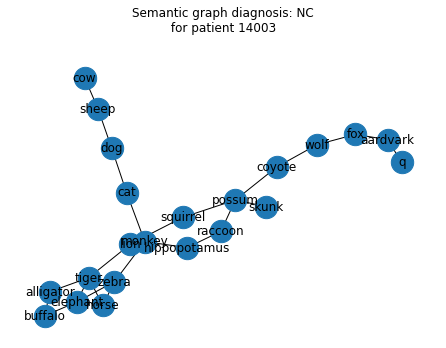

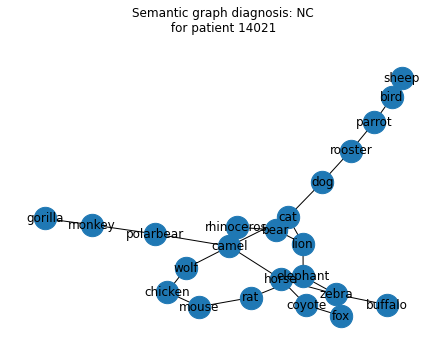

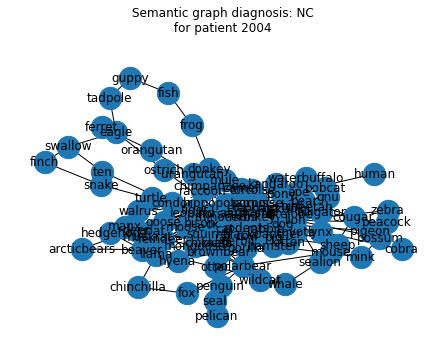

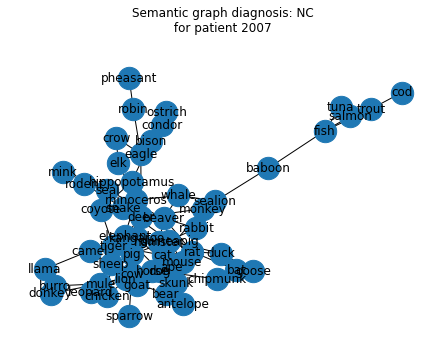

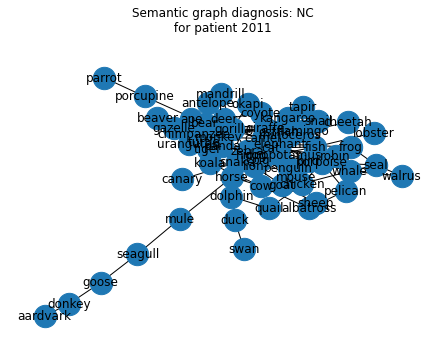

...

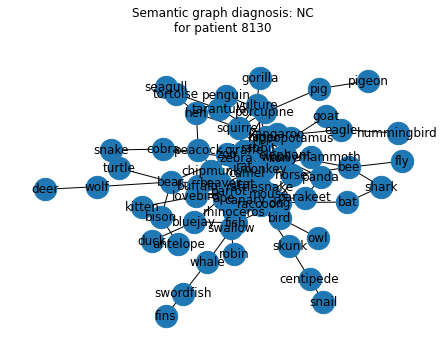

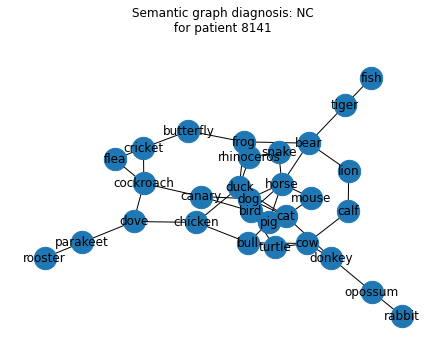

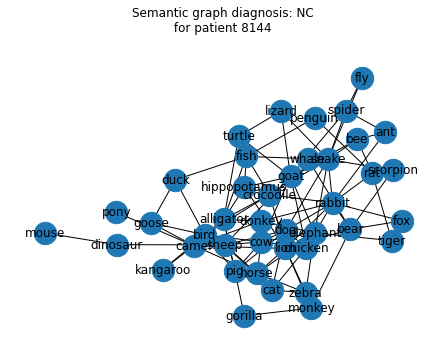

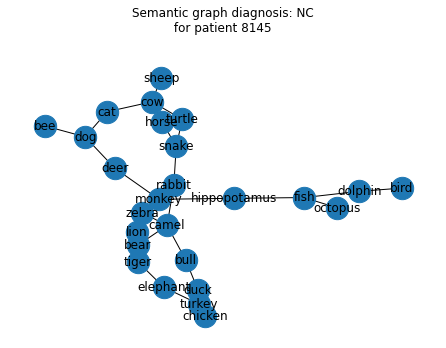

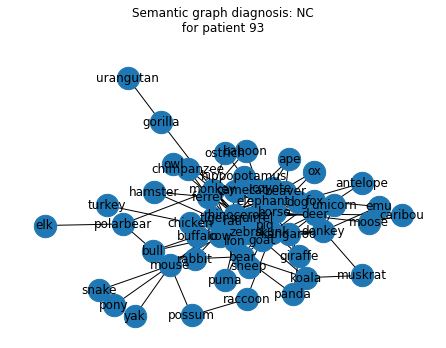

In [8]:
visualize_all_graphs(df_nc)

### A bit of interpretation

I would say these graphs look pretty good if they low number of nodes. 

However they still don't give insights into how alzhiemers patients produce lists. 

### UMAP

Working with UMAP for a simple example. 

CPU times: user 5.69 s, sys: 142 ms, total: 5.83 s
Wall time: 4.31 s


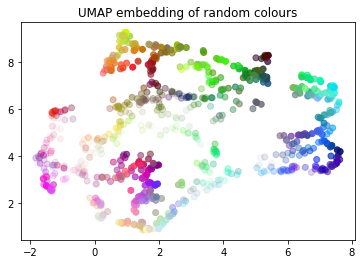

In [10]:
np.random.seed(42)
data = np.random.rand(800, 4)
fit = umap.UMAP()
%time u = fit.fit_transform(data)
plt.scatter(u[:,0], u[:,1], c=data)
plt.title('UMAP embedding of random colours');

### Exploration of Adjacency Matrices

Here we explore the usage of adjacency matrices as the input into UMAP. 
As one can see it doesn't perform to well. Likely due the the high dimensionality of 
considering all possible nodes as input. 
        
    

In [11]:
## concat both the DataFrames together 
df=pd.concat([df_ad,df_nc],ignore_index=True)
assert len(df)==len(df_ad)+len(df_nc), 'did not concat properly '

def get_all_animals(df:pd.DataFrame): 
    all_animals=set()
    for row in df.itertuples(): 
        for item in row.items.values():
            all_animals.add(item)
    return list(all_animals)
def construct_new_adjacency_matrix(row,temp_adj_matrix):
    for i in np.arange(row.subgraphs.shape[0]):
        for j in np.arange(row.subgraphs.shape[1]):
            temp_adj_matrix.loc[row.items[i]][row.items[j]]=row.subgraphs[i][j]
    return temp_adj_matrix
        # okay so loop over use row.items[0] to get the keys
        # use temp_adj_matrix.loc[row.items[0]][row.items[2]]=1 to make it nice and clean ,
        # if its slow then try boolean indexing and all that cray cray stuff. like who cares if it takes 30 seconds to run 
        # this only has to run once. 
    


all_animals=get_all_animals(df)
temp_adj_matrix=pd.DataFrame(columns=all_animals,data=np.zeros((len(all_animals),len(all_animals))))

temp_adj_matrix['unique_identifier2']=all_animals

temp_adj_matrix=temp_adj_matrix.set_index('unique_identifier2')


## here is where I begin to construct the adjacency matrix of interest####  
global_adj_matrix=[]

for row in tqdm(df.itertuples()):
    new_adjacency_matrix=construct_new_adjacency_matrix(row,temp_adj_matrix.copy())
    assert (new_adjacency_matrix==1).sum().sum()==(row.subgraphs==1).sum(), 'something went wrong in global graph'
    global_adj_matrix.append(new_adjacency_matrix.to_numpy().flatten())
#     G=nx.from_pandas_adjacency(new_adjacency_matrix)
#     nx.draw(G,nodelist=row.items.values(),with_labels=True) #with_labels=True,labels=dict(pd.Series(all_animals)),node_size=500,font_size=12)
#     plt.title(f'network subgraph {row.Index} \n for patient {row.subs} \n  ')
#     plt.show()

assert len(df)==len(global_adj_matrix), 'lengths must be the same'


np.zeros((len(all_animals),len(all_animals))).shape



158it [00:52,  3.01it/s]


(605, 605)

### Attempting UMAP

Here I am attempting do do UMAP for a hyperparameter sweep of 
the number of neighbors and of the minimum distance matrix.
Since the minimum distance is greater than the maximum possible spread 
at points the code fails. However it continues to the next iteration. 

  0%|                                                     | 0/8 [00:00<?, ?it/s]

CPU times: user 6.55 s, sys: 639 ms, total: 7.19 s
Wall time: 7.24 s


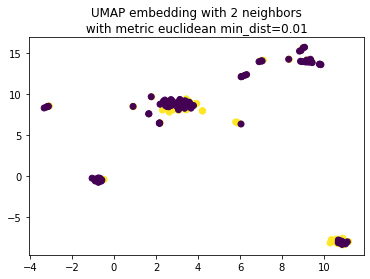

CPU times: user 6.55 s, sys: 628 ms, total: 7.17 s
Wall time: 7.18 s


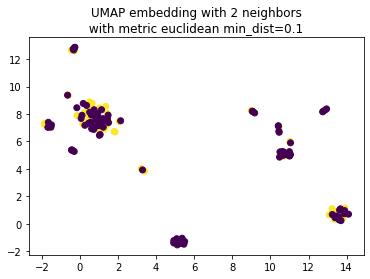

CPU times: user 6.45 s, sys: 599 ms, total: 7.05 s
Wall time: 6.99 s


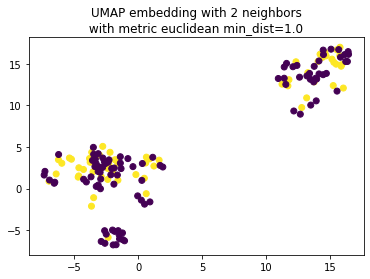

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

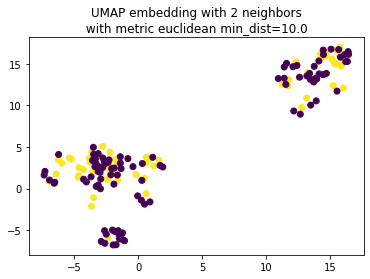

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

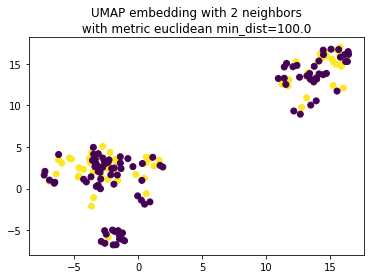

 12%|█████▋                                       | 1/8 [00:24<02:49, 24.21s/it]

CPU times: user 6.54 s, sys: 717 ms, total: 7.26 s
Wall time: 7.4 s


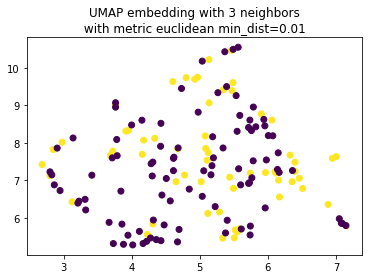

CPU times: user 6.56 s, sys: 640 ms, total: 7.2 s
Wall time: 7.17 s


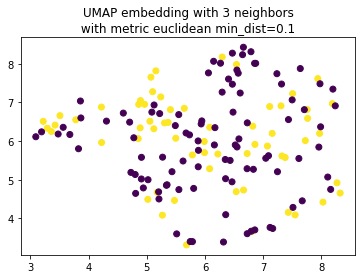

CPU times: user 6.35 s, sys: 626 ms, total: 6.97 s
Wall time: 6.86 s


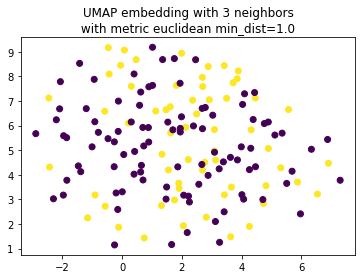

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

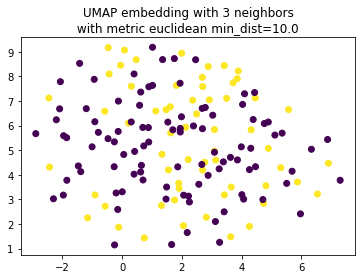

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

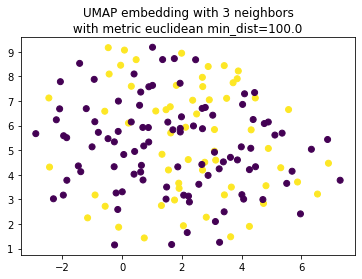

 25%|███████████▎                                 | 2/8 [00:47<02:21, 23.52s/it]

CPU times: user 6.71 s, sys: 639 ms, total: 7.35 s
Wall time: 7.22 s


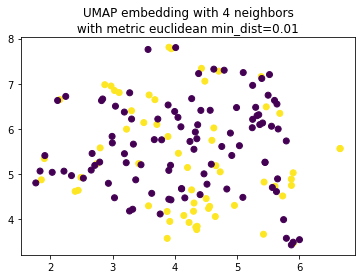

CPU times: user 6.78 s, sys: 645 ms, total: 7.43 s
Wall time: 7.36 s


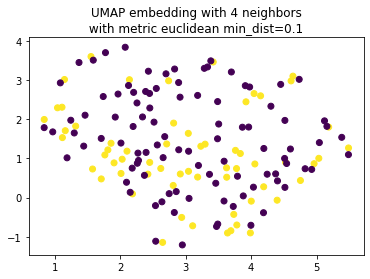

CPU times: user 6.84 s, sys: 657 ms, total: 7.5 s
Wall time: 7.41 s


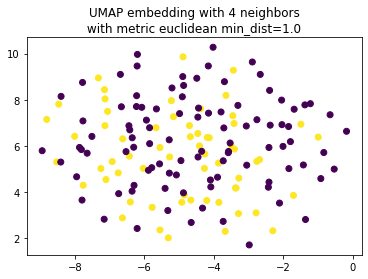

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

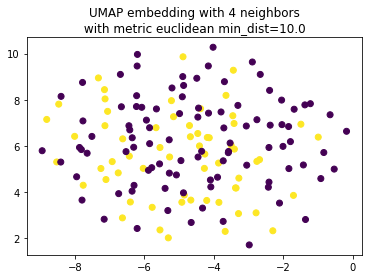

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

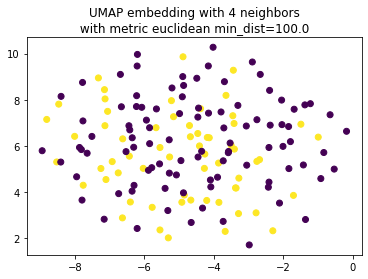

 38%|████████████████▉                            | 3/8 [01:10<01:58, 23.61s/it]

CPU times: user 7.1 s, sys: 681 ms, total: 7.78 s
Wall time: 7.99 s


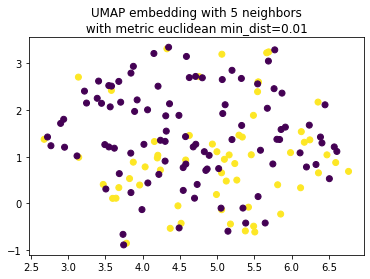

CPU times: user 6.48 s, sys: 644 ms, total: 7.12 s
Wall time: 6.91 s


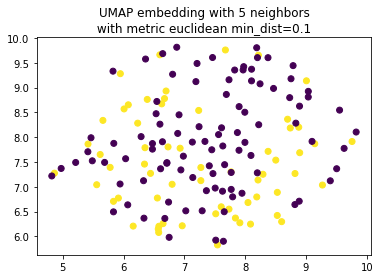

CPU times: user 6.6 s, sys: 606 ms, total: 7.21 s
Wall time: 7.43 s


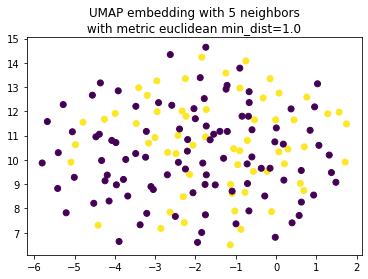

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

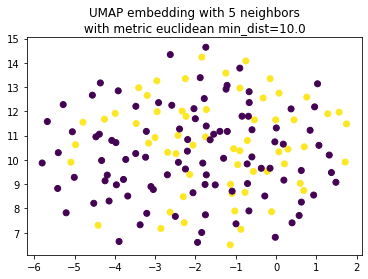

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

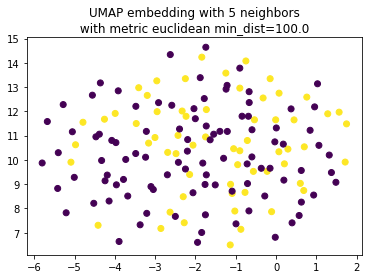

 50%|██████████████████████▌                      | 4/8 [01:35<01:35, 23.82s/it]

CPU times: user 6.47 s, sys: 571 ms, total: 7.05 s
Wall time: 6.62 s


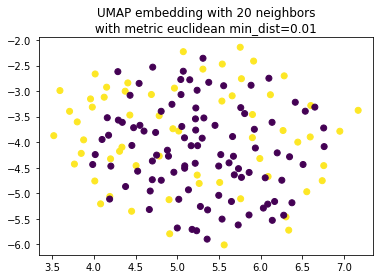

CPU times: user 6.69 s, sys: 618 ms, total: 7.31 s
Wall time: 7.11 s


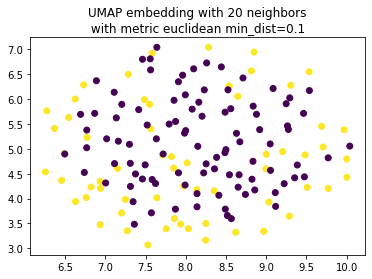

CPU times: user 6.98 s, sys: 603 ms, total: 7.59 s
Wall time: 7.36 s


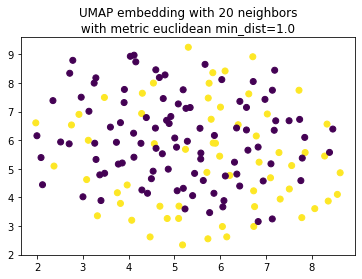

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

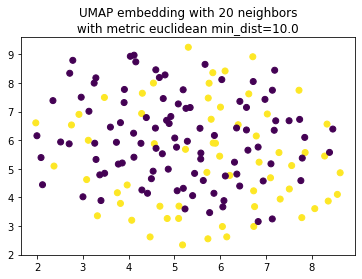

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

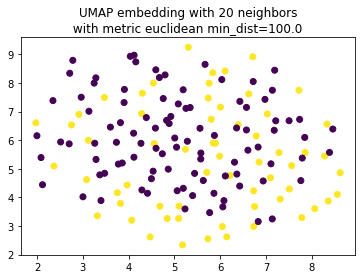

 62%|████████████████████████████▏                | 5/8 [01:58<01:10, 23.54s/it]

CPU times: user 7.41 s, sys: 671 ms, total: 8.08 s
Wall time: 7.74 s


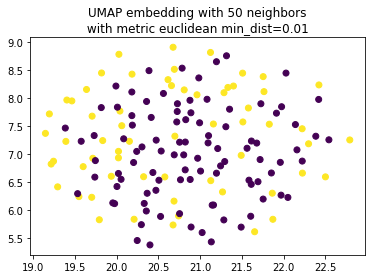

CPU times: user 7.16 s, sys: 687 ms, total: 7.84 s
Wall time: 7.42 s


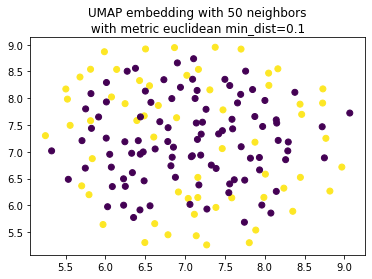

CPU times: user 7.76 s, sys: 665 ms, total: 8.43 s
Wall time: 8.19 s


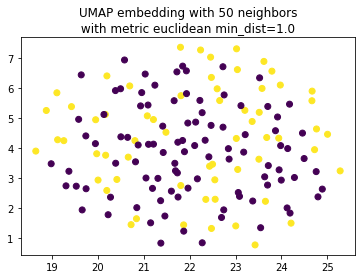

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

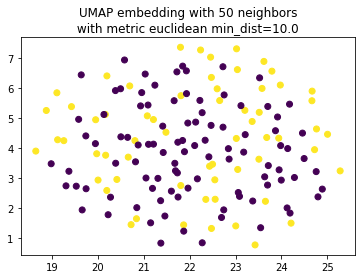

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

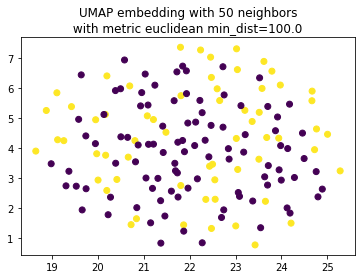

 75%|█████████████████████████████████▊           | 6/8 [02:23<00:48, 24.26s/it]

CPU times: user 7.58 s, sys: 744 ms, total: 8.33 s
Wall time: 8.36 s


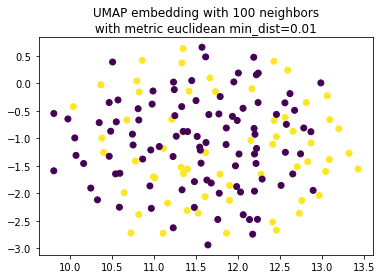

CPU times: user 8.1 s, sys: 726 ms, total: 8.83 s
Wall time: 9.51 s


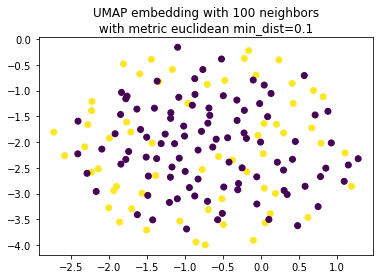

CPU times: user 8.68 s, sys: 748 ms, total: 9.43 s
Wall time: 11.5 s


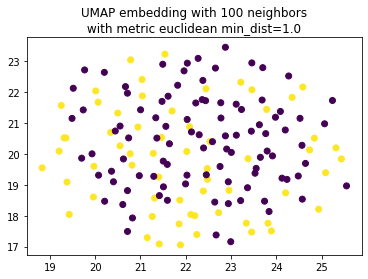

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

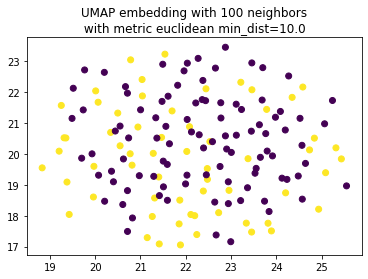

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

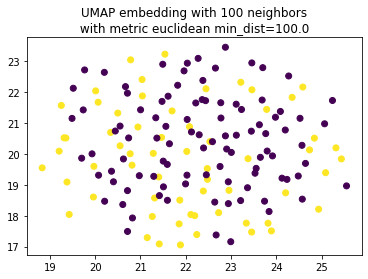

 88%|███████████████████████████████████████▍     | 7/8 [02:55<00:26, 26.62s/it]/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:2344: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  warn(


CPU times: user 8.01 s, sys: 958 ms, total: 8.97 s
Wall time: 9.52 s


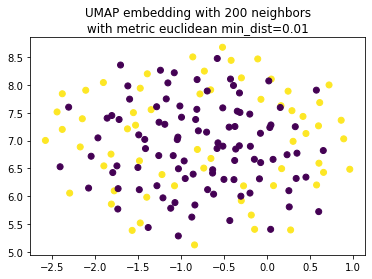

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:2344: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  warn(


CPU times: user 7.7 s, sys: 870 ms, total: 8.57 s
Wall time: 8.1 s


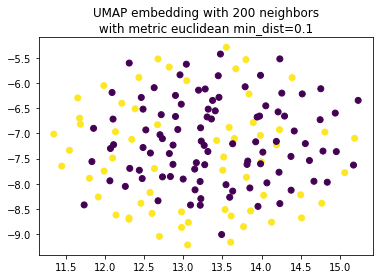

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:2344: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  warn(


CPU times: user 7.09 s, sys: 806 ms, total: 7.9 s
Wall time: 7.17 s


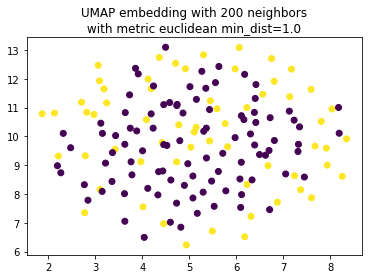

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

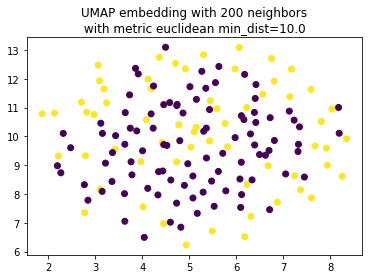

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

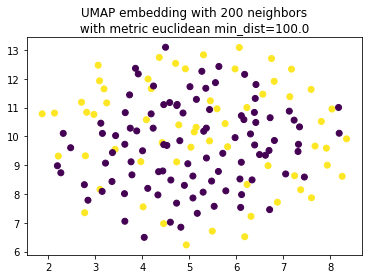

100%|█████████████████████████████████████████████| 8/8 [03:21<00:00, 25.22s/it]


In [12]:

global_adj_matrix=np.array(global_adj_matrix)

for n in tqdm((2,3,4, 5, 20, 50, 100, 200)):
    for p in (1e-2,1e-1,1e0,1e1,1e2):
        metric='euclidean'
        fit = umap.UMAP(n_neighbors=n,metric=metric,min_dist=p)
        %time u = fit.fit_transform(global_adj_matrix)
        plt.scatter(u[:,0], u[:,1],c=df['diagnosis']=='AD')
        plt.title(f'UMAP embedding with {n} neighbors\n with metric {metric} min_dist={p} ')
        plt.show()
#     draw_umap(n_neighbors=n, title='n_neighbors = {}'.format(n))

#### so maybe the graphical representation isn't the best idea ... lol... yikes 

  0%|                                                     | 0/8 [00:00<?, ?it/s]/opt/anaconda3/envs/jup/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


CPU times: user 3.18 s, sys: 510 ms, total: 3.69 s
Wall time: 3.71 s


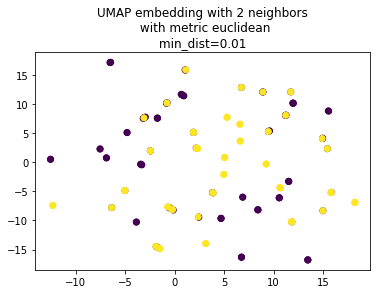

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


CPU times: user 2.82 s, sys: 74.5 ms, total: 2.89 s
Wall time: 2.79 s


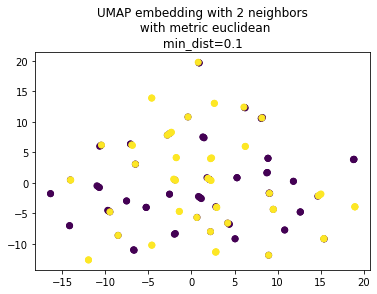

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


CPU times: user 2.88 s, sys: 98.8 ms, total: 2.98 s
Wall time: 2.93 s


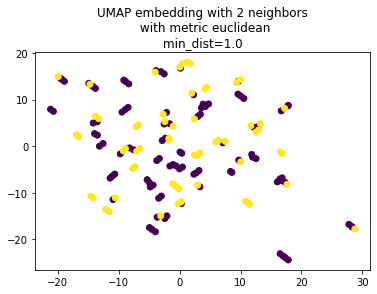

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

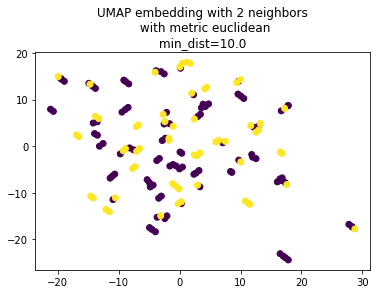

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

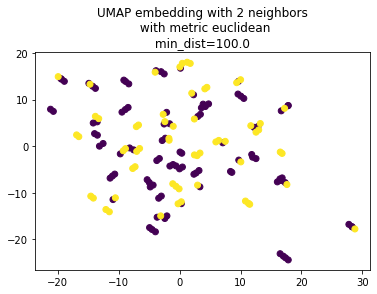

 12%|█████▋                                       | 1/8 [00:10<01:13, 10.50s/it]/opt/anaconda3/envs/jup/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


CPU times: user 3.17 s, sys: 112 ms, total: 3.28 s
Wall time: 3.3 s


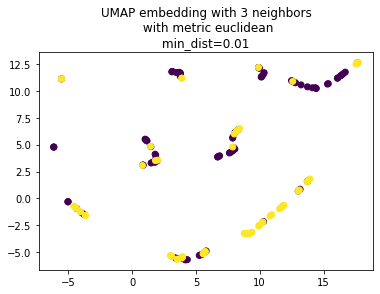

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


CPU times: user 2.62 s, sys: 79.6 ms, total: 2.7 s
Wall time: 2.55 s


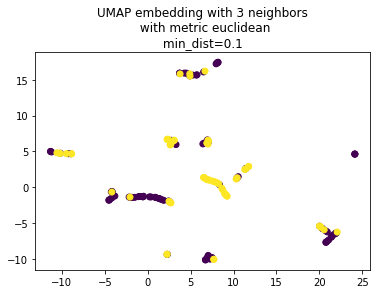

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


CPU times: user 2.82 s, sys: 76.9 ms, total: 2.9 s
Wall time: 2.73 s


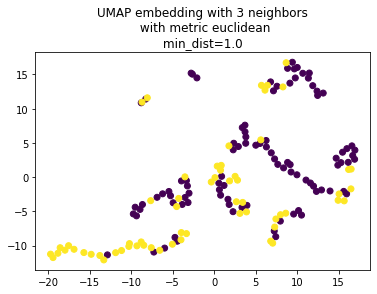

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

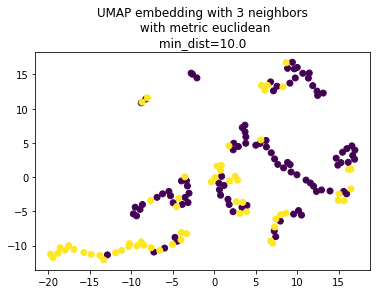

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

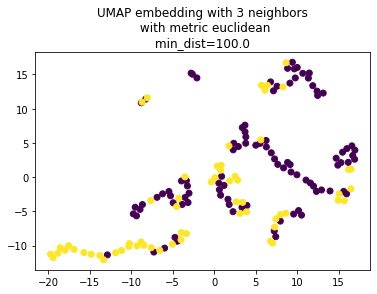

 25%|███████████▎                                 | 2/8 [00:20<01:00, 10.03s/it]/opt/anaconda3/envs/jup/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


CPU times: user 3.14 s, sys: 137 ms, total: 3.28 s
Wall time: 3.45 s


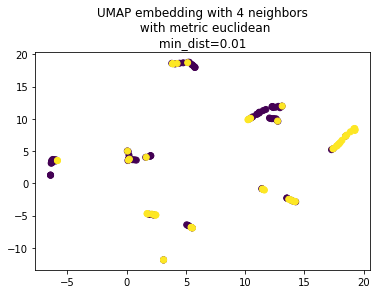

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


CPU times: user 2.89 s, sys: 77.8 ms, total: 2.97 s
Wall time: 2.79 s


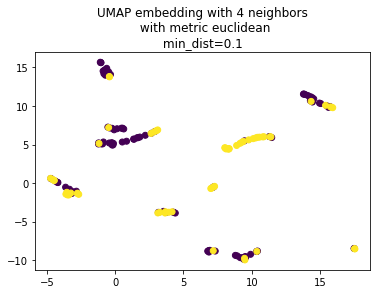

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


CPU times: user 2.64 s, sys: 77.5 ms, total: 2.71 s
Wall time: 2.51 s


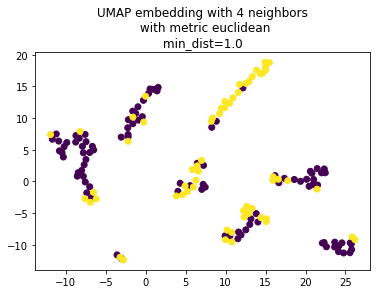

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

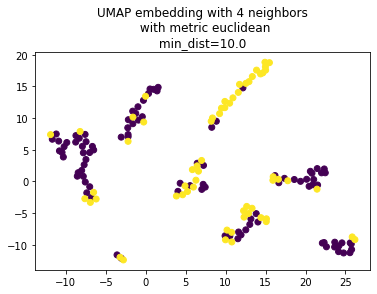

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

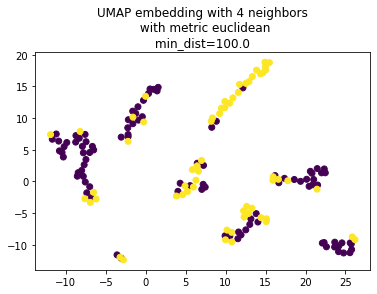

 38%|████████████████▉                            | 3/8 [00:30<00:49,  9.98s/it]/opt/anaconda3/envs/jup/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


CPU times: user 2.69 s, sys: 80.3 ms, total: 2.77 s
Wall time: 2.55 s


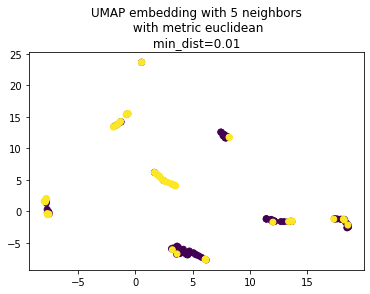

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


CPU times: user 2.98 s, sys: 81.3 ms, total: 3.06 s
Wall time: 2.86 s


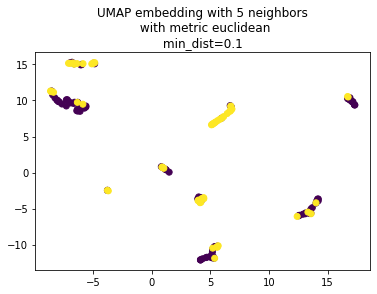

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


CPU times: user 2.8 s, sys: 80.1 ms, total: 2.88 s
Wall time: 2.65 s


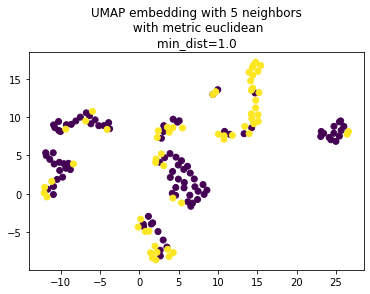

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

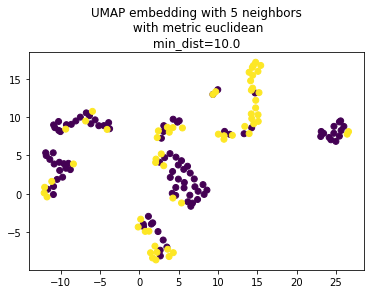

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

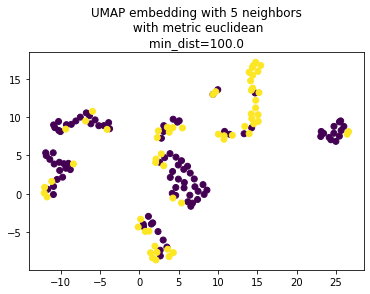

 50%|██████████████████████▌                      | 4/8 [00:39<00:38,  9.60s/it]

CPU times: user 3.11 s, sys: 82.4 ms, total: 3.19 s
Wall time: 2.79 s


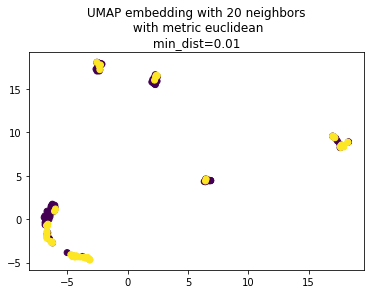

CPU times: user 2.94 s, sys: 90.2 ms, total: 3.03 s
Wall time: 2.61 s


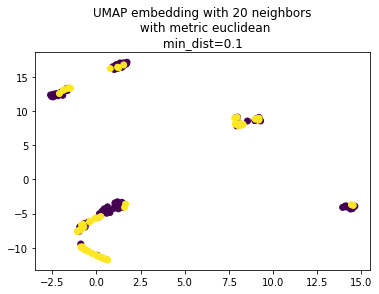

CPU times: user 3.15 s, sys: 84.5 ms, total: 3.23 s
Wall time: 2.83 s


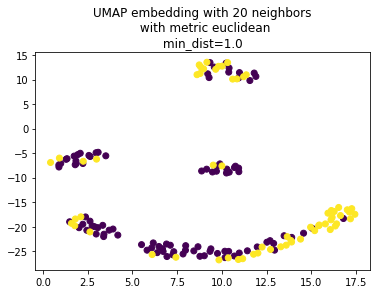

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

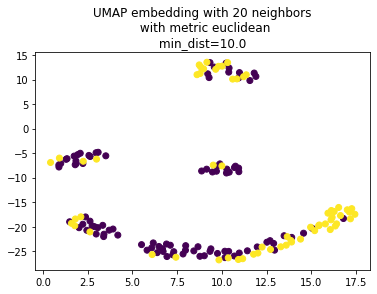

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

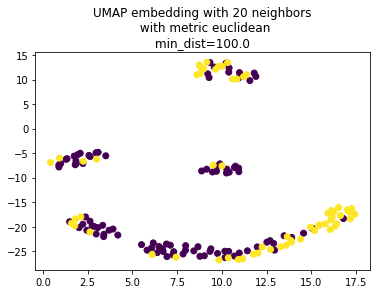

 62%|████████████████████████████▏                | 5/8 [00:48<00:28,  9.46s/it]

CPU times: user 3.07 s, sys: 84.6 ms, total: 3.16 s
Wall time: 2.67 s


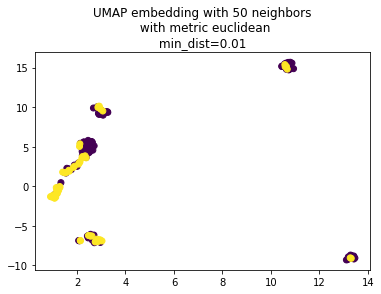

CPU times: user 3.51 s, sys: 101 ms, total: 3.61 s
Wall time: 3.22 s


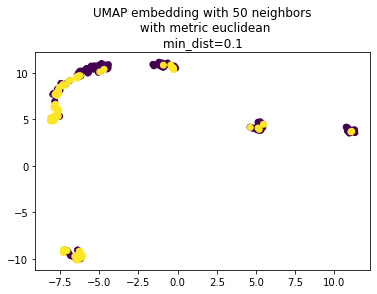

CPU times: user 3.53 s, sys: 144 ms, total: 3.67 s
Wall time: 3.58 s


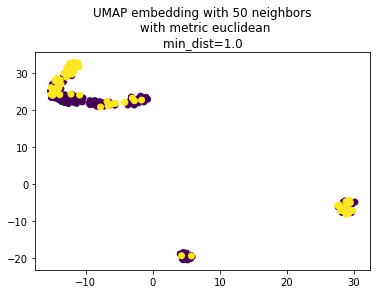

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

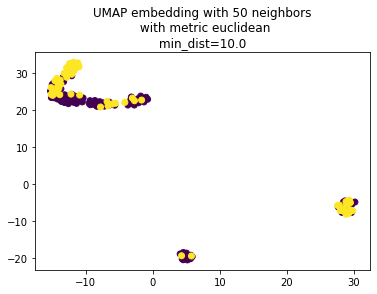

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

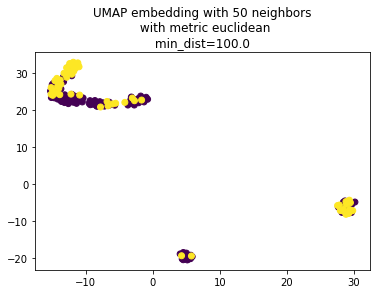

 75%|█████████████████████████████████▊           | 6/8 [00:59<00:19,  9.87s/it]

CPU times: user 3.62 s, sys: 106 ms, total: 3.72 s
Wall time: 3.19 s


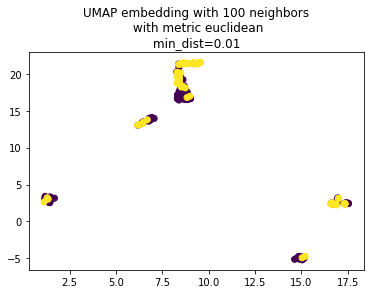

CPU times: user 3.18 s, sys: 89.3 ms, total: 3.27 s
Wall time: 2.69 s


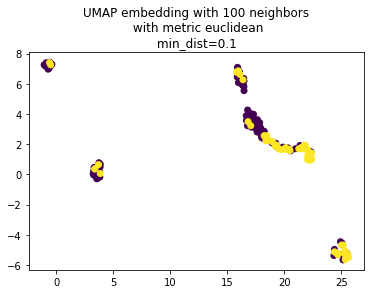

CPU times: user 3.38 s, sys: 92.3 ms, total: 3.47 s
Wall time: 2.9 s


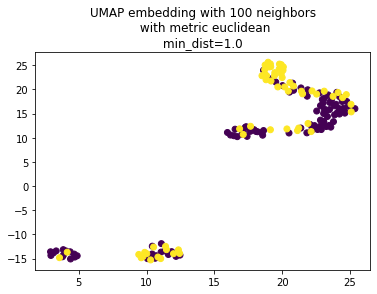

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

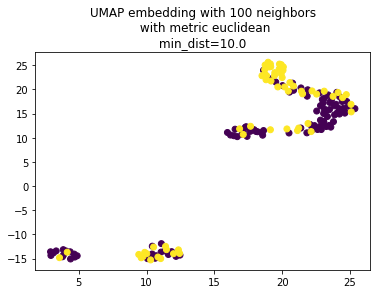

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

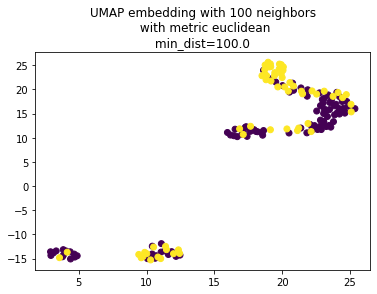

 88%|███████████████████████████████████████▍     | 7/8 [01:08<00:09,  9.84s/it]/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:2344: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  warn(


CPU times: user 3.23 s, sys: 85.8 ms, total: 3.32 s
Wall time: 2.73 s


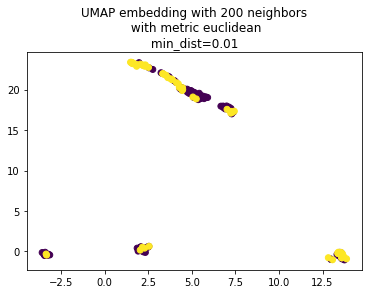

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:2344: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  warn(


CPU times: user 3.55 s, sys: 90.1 ms, total: 3.64 s
Wall time: 3.24 s


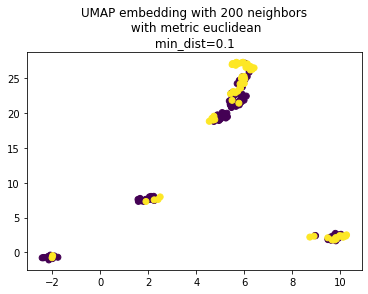

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:2344: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  warn(


CPU times: user 4.09 s, sys: 127 ms, total: 4.22 s
Wall time: 6min 22s


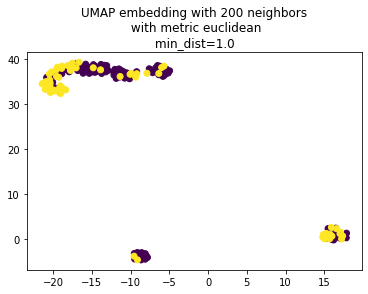

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

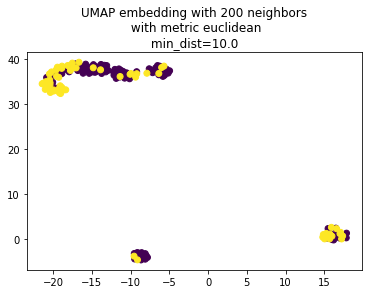

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

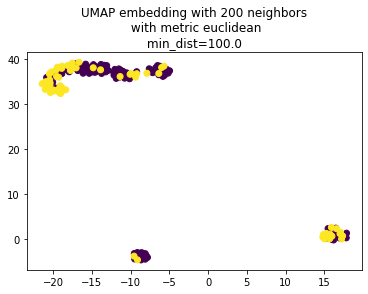

100%|█████████████████████████████████████████████| 8/8 [07:38<00:00, 57.34s/it]


In [13]:
data_ad={"clustering": [0.07692307692307693, 0.2857142857142857, 0.0, 0.08023809523809526, 0.23685714285714288, 0.0, 0.13409961685823757, 0.21937229437229436, 0.0, 0.09954648526077096, 0.14712301587301588, 0.09831349206349205, 0.13333333333333336, 0.05, 0.0, 0.16488095238095238, 0.0, 0.22727807172251618, 0.3, 0.0906746031746032, 0.04444444444444444, 0.3179673721340388, 0.1311111111111111, 0.09999999999999999, 0.10864197530864199, 0.33934213934213936, 0.06818181818181818, 0.06249999999999999, 0.0, 0.20717399884066545, 0.044241810199257, 0.1607553366174056, 0.08124999999999999, 0.28787878787878785, 0.27391577320583405, 0.1383333333333333, 0.0, 0.0840757808499744, 0.07152777777777777, 0.08617283950617283, 0.13823953823953825, 0.090625, 0.020512820512820513, 0.04838709677419355, 0.012913640032284098, 0.23809523809523808, 0.19047619047619047, 0.0, 0.0, 0.0, 0.125, 0.11848739495798319, 0.2783933080808081, 0.15247887033601318, 0.0, 0.25641025641025644, 0.3498563165229832, 0.14629629629629629, 0.1041847041847042, 0.11698043558508675, 0.1425249169435216], "diameter": [7.0, 4.0, 12.0, 11.0, 7.0, 6.0, 9.0, 6.0, 5.0, 10.0, 6.0, 7.0, 5.0, 5.0, 15.0, 8.0, 5.0, 6.0, 6.0, 17.0, 7.0, 7.0, 4.0, 9.0, 9.0, 7.0, 12.0, 10.0, 8.0, 7.0, 7.0, 6.0, 6.0, 8.0, 5.0, 5.0, 12.0, 6.0, 5.0, 16.0, 6.0, 9.0, 8.0, 11.0, 12.0, 10.0, 3.0, 8.0, 5.0, 11.0, 8.0, 16.0, 5.0, 5.0, 10.0, 5.0, 4.0, 6.0, 7.0, 6.0, 7.0], "number_of_nodes": [13.0, 14.0, 17.0, 50.0, 25.0, 12.0, 29.0, 22.0, 12.0, 56.0, 32.0, 40.0, 10.0, 22.0, 16.0, 32.0, 12.0, 27.0, 15.0, 60.0, 15.0, 36.0, 15.0, 39.0, 27.0, 39.0, 22.0, 32.0, 13.0, 36.0, 47.0, 29.0, 16.0, 11.0, 29.0, 20.0, 20.0, 31.0, 32.0, 45.0, 33.0, 32.0, 26.0, 31.0, 59.0, 14.0, 7.0, 18.0, 13.0, 12.0, 12.0, 34.0, 32.0, 28.0, 15.0, 13.0, 27.0, 18.0, 33.0, 43.0, 43.0], "subs": ["14003", "14021", "2017", "2087", "2095", "2201", "2297", "2330", "2366", "2390", "2445", "2567", "2595", "2652", "2667", "2677", "2679", "2722", "2728", "2766", "2767", "2792", "2821", "2864", "2868", "2886", "2896", "2987", "3008", "3023", "3029", "3035", "3045", "3053", "3071", "3092", "3127", "3130", "3149", "3163", "3187", "3194", "3207", "3213", "3242", "3277", "3326", "653", "654", "8004", "8046", "8052", "8063", "8126", "8130", "8140", "8141", "8144", "8151", "8163", "8176"], "density": [0.1794871794871795, 0.21978021978021978, 0.11764705882352941, 0.0563265306122449, 0.15, 0.21212121212121213, 0.10344827586206896, 0.17316017316017315, 0.18181818181818182, 0.05584415584415584, 0.11290322580645161, 0.09487179487179487, 0.2222222222222222, 0.17316017316017315, 0.125, 0.09274193548387097, 0.19696969696969696, 0.1452991452991453, 0.18095238095238095, 0.04971751412429379, 0.1619047619047619, 0.10952380952380952, 0.22857142857142856, 0.06747638326585695, 0.09971509971509972, 0.09176788124156546, 0.09956709956709957, 0.07661290322580645, 0.16666666666666666, 0.12222222222222222, 0.06567992599444958, 0.11576354679802955, 0.2, 0.23636363636363636, 0.18472906403940886, 0.14736842105263157, 0.1, 0.0989247311827957, 0.0967741935483871, 0.06868686868686869, 0.10984848484848485, 0.07862903225806452, 0.09538461538461539, 0.07741935483870968, 0.04266510812390415, 0.16483516483516483, 0.42857142857142855, 0.12418300653594772, 0.15384615384615385, 0.16666666666666666, 0.18181818181818182, 0.0677361853832442, 0.16330645161290322, 0.1402116402116402, 0.13333333333333333, 0.23076923076923078, 0.18803418803418803, 0.1437908496732026, 0.10227272727272728, 0.07751937984496124, 0.08084163898117387], "median_degree": [2.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.5, 1.0, 2.0, 2.5, 3.0, 2.0, 3.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 2.0, 4.0, 2.5, 2.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 2.0, 2.0, 4.5, 2.5, 2.0, 2.0, 4.0, 2.0, 3.0, 2.0, 3.0], "persev_data": [0.0, 0.17777777777777778, 0.15, 0.08305813553491573, 0.022222222222222223, 0.2932692307692308, 0.28286380286380286, 0.2111111111111111, 0.037037037037037035, 0.08673128342245989, 0.10925582354153782, 0.16307446055345215, 0.13392857142857142, 0.15645095645095644, 0.0, 0.10016025641025642, 0.19090909090909092, 0.17327647842353724, 0.17619047619047618, 0.11629809818664308, 0.07692307692307693, 0.08630341880341881, 0.2874493927125506, 0.09904970760233918, 0.22083333333333333, 0.06734539969834089, 0.0, 0.1661209161209161, 0.0, 0.23202793938088057, 0.13431188264779598, 0.04730392156862745, 0.1346153846153846, 0.0, 0.2255690737833595, 0.045454545454545456, 0.0, 0.12916666666666665, 0.08443223443223444, 0.19150326797385625, 0.13253458498023715, 0.014705882352941176, 0.059027777777777776, 0.052380952380952375, 0.011904761904761904, 0.125, 0.25, 0.07142857142857142, 0.0, 0.0, 0.125, 0.042328042328042326, 0.09560897435897436, 0.23547979797979796, 0.0625, 0.363961038961039, 0.3117237182185358, 0.10512820512820513, 0.11822916666666666, 0.04421768707482993, 0.13180272108843538], "mean_degree": [2.1538461538461537, 2.857142857142857, 1.8823529411764706, 2.76, 3.6, 2.3333333333333335, 2.896551724137931, 3.6363636363636362, 2.0, 3.0714285714285716, 3.5, 3.7, 2.0, 3.6363636363636362, 1.875, 2.875, 2.1666666666666665, 3.7777777777777777, 2.533333333333333, 2.933333333333333, 2.2666666666666666, 3.8333333333333335, 3.2, 2.5641025641025643, 2.5925925925925926, 3.4871794871794872, 2.090909090909091, 2.375, 2.0, 4.277777777777778, 3.021276595744681, 3.2413793103448274, 3.0, 2.3636363636363638, 5.172413793103448, 2.8, 1.9, 2.967741935483871, 3.0, 3.022222222222222, 3.515151515151515, 2.4375, 2.3846153846153846, 2.3225806451612905, 2.4745762711864407, 2.142857142857143, 2.5714285714285716, 2.111111111111111, 1.8461538461538463, 1.8333333333333333, 2.0, 2.235294117647059, 5.0625, 3.7857142857142856, 1.8666666666666667, 2.769230769230769, 4.888888888888889, 2.4444444444444446, 3.272727272727273, 3.255813953488372, 3.395348837209302], "numlists": [2.0, 3.0, 1.0, 9.0, 3.0, 2.0, 5.0, 6.0, 3.0, 8.0, 7.0, 7.0, 2.0, 6.0, 1.0, 8.0, 2.0, 8.0, 2.0, 7.0, 2.0, 10.0, 2.0, 6.0, 3.0, 5.0, 2.0, 6.0, 2.0, 9.0, 7.0, 6.0, 6.0, 1.0, 7.0, 4.0, 2.0, 6.0, 7.0, 5.0, 4.0, 4.0, 4.0, 4.0, 6.0, 1.0, 2.0, 2.0, 3.0, 1.0, 2.0, 6.0, 10.0, 8.0, 1.0, 4.0, 6.0, 2.0, 8.0, 7.0, 7.0], "persev_params": [0.0, 1.0, 0.02, 0.14, 0.03, 0.26, 0.84, 1.0, 0.05, 0.26, 0.31, 0.56, 0.16, 0.45, 0.0, 0.2, 0.16, 0.77, 0.15, 0.11, 0.09, 0.45, 1.0, 0.1, 0.16, 0.1, 0.0, 0.15, 0.0, 0.67, 0.24, 0.1, 0.12, 0.0, 1.0, 0.06, 0.0, 0.25, 0.26, 0.42, 0.86, 0.02, 0.06, 0.05, 0.02, 0.01, 0.36, 0.03, 0.0, 0.0, 0.08, 0.05, 0.25, 0.87, 0.01, 0.47, 0.94, 0.08, 0.33, 0.12, 0.29], "spl": [3.0, 2.241758241758242, 4.970588235294118, 4.169795918367347, 2.776666666666667, 2.590909090909091, 3.4926108374384235, 2.6233766233766236, 2.6363636363636362, 3.8487012987012985, 2.8004032258064515, 2.9833333333333334, 2.577777777777778, 2.3852813852813854, 5.666666666666667, 3.3891129032258065, 2.393939393939394, 2.6096866096866096, 2.8857142857142857, 5.444067796610169, 3.038095238095238, 2.846031746031746, 2.0952380952380953, 3.8110516934046346, 3.7834757834757835, 3.2550607287449393, 4.4978354978354975, 4.161290322580645, 3.358974358974359, 2.742857142857143, 3.2275670675300647, 2.8916256157635467, 2.4916666666666667, 3.4363636363636365, 2.1699507389162562, 2.9, 4.994736842105263, 2.9698924731182794, 2.8629032258064515, 5.268686868686869, 2.965909090909091, 3.8870967741935485, 3.7446153846153845, 4.232258064516129, 5.182933956750438, 4.274725274725275, 1.7142857142857142, 3.6013071895424837, 2.25, 4.333333333333333, 3.378787878787879, 5.374331550802139, 2.350806451612903, 2.4126984126984126, 4.380952380952381, 2.423076923076923, 2.133903133903134, 2.9411764705882355, 3.102272727272727, 3.0753045404208197, 3.1727574750830563], "smallworld": [0.5173721502874179, 1.5699013547107612, 0.0, 1.3432702597576216, 1.48859916013564, 0.0, 1.2171084144735351, 1.2113246551610766, 0.0, 1.6916676325440827, 1.3288272998080979, 1.0044905068146979, 0.8591193348846627, 0.30364756938745896, 0.0, 1.777077893621128, 0.0, 1.5434509727479337, 1.7933182278432351, 1.2961874563958067, 0.3203748233844747, 2.7981106806589486, 0.6829172461662436, 1.3397621145582306, 1.0345814804515354, 3.419618433957679, 0.6684012056690986, 0.8108098382675003, 0.0, 1.5672231200997584, 0.7425284926010829, 1.4241830599963174, 0.4389076546584051, 1.0868077022090097, 1.4501932892378002, 0.9913501632211905, 0.0, 0.9335010574681211, 0.8407130738252117, 0.8381975100477632, 1.2170683711117005, 1.1905810877033753, 0.22392285718358537, 0.6218488860299632, 0.26733804615213363, 1.2600603810726985, 0.6231886565049295, 0.0, 0.0, 0.0, 0.7957652187699428, 1.470148699807362, 1.59959061159865, 1.170021604276803, 0.0, 1.2509515456373042, 1.8804723774548826, 1.1844295968975709, 0.9986555608481857, 1.6007210453360878, 1.7504461872278037]}
data_nc= {"clustering": [0.0, 0.0, 0.16283181104609676, 0.08822087873812011, 0.14443768037518034, 0.1318786081296335, 0.12548083575480834, 0.1026666666666667, 0.11139122315592904, 0.12232365058452017, 0.10642551892551891, 0.020436507936507937, 0.16712247188437668, 0.12373737373737376, 0.18640890699714233, 0.06928300865800865, 0.07519841269841271, 0.04523809523809524, 0.11749890002902051, 0.0890952380952381, 0.05376344086021505, 0.015343915343915344, 0.15005692719978433, 0.22310643501119692, 0.048337825696316256, 0.18711493634570553, 0.09908103592314119, 0.17034785545423844, 0.14212454212454212, 0.1382045490741143, 0.009842325695984231, 0.16254578754578755, 0.18634510913922683, 0.030263387406244548, 0.06518620268620269, 0.1884421712546713, 0.120155981584553, 0.08767873540600814, 0.058888888888888886, 0.10423881673881673, 0.11636363636363636, 0.1342926019955059, 0.07882251082251082, 0.2732067007067007, 0.0634801799507682, 0.03958333333333334, 0.04791666666666667, 0.1984225034225034, 0.0, 0.1680861650426868, 0.12866522366522365, 0.11265734265734266, 0.10748299319727889, 0.07738759839600175, 0.14245187436676798, 0.1339306688143897, 0.178531613314222, 0.1362348588911089, 0.1457477565169873, 0.06759259259259259, 0.11609195402298851, 0.20257252326217845, 0.04249792760431058, 0.14503968253968255, 0.13939529305382967, 0.0, 0.11992562992562991, 0.10586781160551652, 0.10536715375425054, 0.08484848484848485, 0.059829059829059825, 0.11666666666666667, 0.0, 0.12037037037037036, 0.0, 0.0, 0.09229864785420341, 0.0, 0.06111317254174397, 0.12009839668067515, 0.10590468853180719, 0.14595569040013484, 0.11793650793650795, 0.10713997113997113, 0.19579300861052198, 0.1781058351370851, 0.17777845050572322, 0.04698258091115234, 0.24488807488807487, 0.09722222222222221, 0.05555555555555555, 0.08970162069335626, 0.07060090702947847, 0.09888888888888889, 0.22144792876500194, 0.038461538461538464, 0.17372193391463167], "diameter": [12.0, 9.0, 8.0, 9.0, 9.0, 11.0, 10.0, 7.0, 8.0, 11.0, 6.0, 9.0, 13.0, 7.0, 10.0, 17.0, 8.0, 11.0, 7.0, 16.0, 12.0, 10.0, 8.0, 5.0, 17.0, 11.0, 9.0, 6.0, 10.0, 15.0, 11.0, 12.0, 8.0, 12.0, 7.0, 9.0, 10.0, 8.0, 13.0, 6.0, 16.0, 9.0, 11.0, 7.0, 15.0, 9.0, 7.0, 8.0, 14.0, 10.0, 7.0, 12.0, 7.0, 10.0, 10.0, 8.0, 10.0, 10.0, 8.0, 8.0, 14.0, 7.0, 7.0, 7.0, 12.0, 9.0, 9.0, 10.0, 20.0, 13.0, 8.0, 18.0, 21.0, 6.0, 14.0, 21.0, 10.0, 11.0, 10.0, 12.0, 10.0, 6.0, 7.0, 5.0, 7.0, 8.0, 7.0, 9.0, 9.0, 7.0, 14.0, 14.0, 9.0, 8.0, 6.0, 9.0, 5.0], "number_of_nodes": [22.0, 23.0, 98.0, 58.0, 64.0, 159.0, 73.0, 25.0, 51.0, 69.0, 52.0, 40.0, 63.0, 44.0, 51.0, 80.0, 72.0, 60.0, 83.0, 100.0, 31.0, 66.0, 70.0, 63.0, 53.0, 65.0, 57.0, 47.0, 57.0, 92.0, 82.0, 52.0, 68.0, 91.0, 52.0, 96.0, 105.0, 66.0, 60.0, 48.0, 55.0, 79.0, 100.0, 60.0, 85.0, 32.0, 32.0, 60.0, 48.0, 115.0, 70.0, 65.0, 42.0, 119.0, 47.0, 86.0, 92.0, 64.0, 65.0, 36.0, 29.0, 58.0, 47.0, 48.0, 82.0, 27.0, 65.0, 61.0, 93.0, 55.0, 39.0, 20.0, 22.0, 18.0, 18.0, 22.0, 54.0, 26.0, 70.0, 79.0, 118.0, 54.0, 50.0, 50.0, 88.0, 64.0, 66.0, 84.0, 60.0, 24.0, 27.0, 121.0, 70.0, 30.0, 41.0, 26.0, 58.0], "subs": ["14003", "14021", "2004", "2007", "2011", "2015", "2016", "2032", "2053", "2060", "2080", "2086", "2090", "2093", "2099", "2115", "2146", "2157", "2172", "2294", "2366", "2367", "2408", "2423", "2444", "2447", "2449", "2452", "2456", "2461", "2462", "2481", "2491", "2495", "2501", "2544", "2558", "2559", "2566", "2568", "2570", "2573", "2575", "2579", "2583", "2589", "2595", "2598", "2603", "2608", "2611", "2621", "2628", "2634", "2636", "2645", "2650", "2656", "2663", "2664", "2667", "2670", "2679", "2728", "2754", "2767", "2820", "2821", "2824", "2894", "2896", "2951", "3008", "3127", "5", "6", "603", "6079", "610", "617", "618", "628", "641", "644", "647", "653", "654", "8011", "8027", "8046", "8052", "8094", "8130", "8141", "8144", "8145", "93"], "density": [0.1038961038961039, 0.10276679841897234, 0.046286555859457186, 0.05928614640048397, 0.06696428571428571, 0.02842130403630284, 0.05098934550989345, 0.12666666666666668, 0.06980392156862746, 0.051577152600170505, 0.08069381598793364, 0.06923076923076923, 0.05632360471070148, 0.07188160676532769, 0.08392156862745098, 0.0379746835443038, 0.041471048513302036, 0.04463276836158192, 0.0526006464883926, 0.028888888888888888, 0.07311827956989247, 0.04195804195804196, 0.05714285714285714, 0.08858166922683051, 0.04499274310595065, 0.05961538461538462, 0.05576441102756892, 0.0786308973172988, 0.05200501253132832, 0.033205924510272336, 0.03643480879253237, 0.05731523378582202, 0.06321334503950835, 0.0380952380952381, 0.06033182503770739, 0.04451754385964912, 0.03553113553113553, 0.05827505827505827, 0.04067796610169491, 0.07535460992907801, 0.04579124579124579, 0.06004543979227524, 0.032929292929292926, 0.07966101694915254, 0.037815126050420166, 0.07459677419354839, 0.09274193548387097, 0.07457627118644068, 0.04609929078014184, 0.03646071700991609, 0.0567287784679089, 0.058653846153846154, 0.08362369337979095, 0.031476997578692496, 0.0666049953746531, 0.046785225718194254, 0.04228380315336837, 0.06646825396825397, 0.06201923076923077, 0.0873015873015873, 0.0812807881773399, 0.05868118572292801, 0.07215541165587419, 0.06826241134751773, 0.04938271604938271, 0.08547008547008547, 0.06009615384615385, 0.05792349726775956, 0.033660589060308554, 0.041750841750841754, 0.06612685560053981, 0.10526315789473684, 0.09090909090909091, 0.13725490196078433, 0.1111111111111111, 0.09090909090909091, 0.061495457721872815, 0.08615384615384615, 0.047619047619047616, 0.04771178188899708, 0.030856149500217298, 0.07617051013277429, 0.07755102040816327, 0.0783673469387755, 0.06269592476489028, 0.06398809523809523, 0.07179487179487179, 0.03843947217441193, 0.07570621468926554, 0.10869565217391304, 0.08262108262108261, 0.03016528925619835, 0.04803312629399586, 0.09885057471264368, 0.11829268292682926, 0.09230769230769231, 0.08711433756805807], "median_degree": [2.0, 2.0, 3.0, 2.5, 2.5, 3.0, 3.0, 2.0, 3.0, 2.0, 4.0, 2.0, 2.0, 3.0, 3.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 3.0, 5.0, 2.0, 3.0, 2.0, 3.0, 2.0, 2.0, 2.0, 2.5, 2.0, 2.0, 2.0, 3.0, 2.0, 3.0, 2.0, 3.0, 2.0, 3.0, 2.0, 3.0, 2.0, 2.0, 2.5, 4.0, 2.0, 3.0, 2.5, 4.0, 3.0, 2.0, 3.0, 4.0, 2.5, 2.5, 2.0, 3.0, 2.0, 2.0, 2.0, 3.0, 3.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 2.0, 3.0, 4.0, 2.5, 4.0, 3.0, 3.0, 2.0, 4.0, 2.0, 2.0, 2.0, 2.0, 2.5, 4.0, 2.0, 3.5], "persev_data": [0.03125, 0.09453781512605042, 0.023359706201321107, 0.03900850611376927, 0.013928571428571429, 0.027056020887178314, 0.013528138528138528, 0.068218954248366, 0.015455304928989139, 0.033113553113553115, 0.016369047619047616, 0.03333333333333333, 0.054839750892382466, 0.026988636363636364, 0.03824189608503334, 0.013636363636363637, 0.0, 0.020869565217391306, 0.03676712779973649, 0.023835701197020536, 0.0, 0.016606280193236716, 0.03882056196297683, 0.030175725375000736, 0.03390293916609706, 0.005952380952380952, 0.006666666666666667, 0.016281512605042014, 0.00909090909090909, 0.01719298245614035, 0.03363167752308024, 0.04632528180354267, 0.08260233918128655, 0.01001602564102564, 0.02708333333333333, 0.032140702107257293, 0.02340267183659632, 0.020847362514029178, 0.017543859649122806, 0.03151515151515152, 0.026625704045058884, 0.04448784298408359, 0.016657870877819725, 0.09749891819869967, 0.018551056786350904, 0.021739130434782608, 0.06818181818181818, 0.017205932940771766, 0.05, 0.03848764049913475, 0.013636363636363636, 0.033134920634920635, 0.0, 0.012351190476190476, 0.030994152046783626, 0.0085548354779124, 0.04326528607421057, 0.02297794117647059, 0.07723119351408825, 0.028985507246376812, 0.029411764705882353, 0.033628207541251016, 0.06395989974937343, 0.06335152261925717, 0.03618796662274923, 0.025641025641025644, 0.08209510564583028, 0.028442317916002127, 0.021466861598440544, 0.010526315789473684, 0.017857142857142856, 0.0, 0.0, 0.1, 0.05263157894736842, 0.0, 0.015546218487394958, 0.0, 0.016514161220043573, 0.011532372146182886, 0.0137016750019846, 0.02001488095238095, 0.025967697020328598, 0.04249817251461988, 0.02749772372450391, 0.06217499500859755, 0.04964502817443993, 0.041359620771385476, 0.10199028581684391, 0.09215686274509804, 0.02631578947368421, 0.026747440593594442, 0.05810457516339869, 0.07342995169082125, 0.08544117647058824, 0.0, 0.02109328579916815], "mean_degree": [2.1818181818181817, 2.260869565217391, 4.489795918367347, 3.3793103448275863, 4.21875, 4.490566037735849, 3.671232876712329, 3.04, 3.4901960784313726, 3.5072463768115942, 4.115384615384615, 2.7, 3.492063492063492, 3.090909090909091, 4.196078431372549, 3.0, 2.9444444444444446, 2.6333333333333333, 4.313253012048193, 2.86, 2.193548387096774, 2.727272727272727, 3.942857142857143, 5.492063492063492, 2.339622641509434, 3.8153846153846156, 3.1228070175438596, 3.617021276595745, 2.912280701754386, 3.0217391304347827, 2.951219512195122, 2.923076923076923, 4.235294117647059, 3.4285714285714284, 3.076923076923077, 4.229166666666667, 3.6952380952380954, 3.787878787878788, 2.4, 3.5416666666666665, 2.4727272727272727, 4.6835443037974684, 3.26, 4.7, 3.176470588235294, 2.3125, 2.875, 4.4, 2.1666666666666665, 4.156521739130435, 3.914285714285714, 3.753846153846154, 3.4285714285714284, 3.7142857142857144, 3.0638297872340425, 3.9767441860465116, 3.847826086956522, 4.1875, 3.9692307692307693, 3.0555555555555554, 2.2758620689655173, 3.3448275862068964, 3.3191489361702127, 3.2083333333333335, 4.0, 2.2222222222222223, 3.8461538461538463, 3.4754098360655736, 3.096774193548387, 2.2545454545454544, 2.5128205128205128, 2.0, 1.9090909090909092, 2.3333333333333335, 1.8888888888888888, 1.9090909090909092, 3.259259259259259, 2.1538461538461537, 3.2857142857142856, 3.721518987341772, 3.610169491525424, 4.037037037037037, 3.8, 3.84, 5.454545454545454, 4.03125, 4.666666666666667, 3.1904761904761907, 4.466666666666667, 2.5, 2.1481481481481484, 3.6198347107438016, 3.3142857142857145, 2.8666666666666667, 4.7317073170731705, 2.3076923076923075, 4.9655172413793105], "numlists": [2.0, 2.0, 14.0, 6.0, 10.0, 19.0, 11.0, 3.0, 7.0, 15.0, 8.0, 5.0, 6.0, 4.0, 9.0, 7.0, 5.0, 4.0, 12.0, 7.0, 2.0, 9.0, 13.0, 12.0, 5.0, 14.0, 6.0, 8.0, 10.0, 10.0, 13.0, 5.0, 12.0, 8.0, 10.0, 13.0, 12.0, 12.0, 6.0, 10.0, 3.0, 14.0, 9.0, 17.0, 11.0, 2.0, 5.0, 17.0, 4.0, 12.0, 10.0, 8.0, 7.0, 16.0, 6.0, 13.0, 12.0, 16.0, 12.0, 3.0, 2.0, 7.0, 5.0, 5.0, 11.0, 3.0, 9.0, 7.0, 10.0, 5.0, 4.0, 1.0, 1.0, 2.0, 1.0, 1.0, 7.0, 2.0, 15.0, 13.0, 13.0, 8.0, 6.0, 8.0, 26.0, 9.0, 20.0, 17.0, 10.0, 3.0, 2.0, 13.0, 10.0, 3.0, 6.0, 2.0, 11.0], "persev_params": [0.02, 0.05, 0.1, 0.09, 0.03, 0.07, 0.02, 0.09, 0.04, 0.04, 0.04, 0.06, 0.07, 0.03, 0.08, 0.01, 0.0, 0.02, 0.11, 0.03, 0.0, 0.03, 0.1, 0.08, 0.02, 0.01, 0.01, 0.03, 0.01, 0.02, 0.0, 0.06, 0.16, 0.02, 0.0, 0.09, 0.07, 0.04, 0.02, 0.06, 0.02, 0.13, 0.02, 0.25, 0.03, 0.01, 0.1, 0.04, 0.01, 0.13, 0.03, 0.07, 0.0, 0.04, 0.06, 0.01, 0.09, 0.05, 0.16, 0.06, 0.01, 0.07, 0.21, 0.1, 0.1, 0.03, 0.41, 0.06, 0.03, 0.01, 0.02, 0.0, 0.0, 0.09, 0.01, 0.0, 0.02, 0.0, 0.0, 0.04, 0.02, 0.04, 0.07, 0.08, 0.07, 0.19, 0.14, 0.0, 0.45, 0.15, 0.01, 0.05, 0.14, 0.07, 0.25, 0.0, 0.08], "spl": [4.536796536796537, 3.8735177865612647, 3.2577319587628866, 3.768905021173624, 3.2222222222222223, 3.7482684499641747, 3.6274733637747336, 3.03, 3.256470588235294, 3.9092071611253196, 2.944193061840121, 3.673076923076923, 4.298515104966718, 3.429175475687104, 3.4211764705882355, 5.1835443037974684, 4.118153364632238, 4.581920903954802, 3.0861004995592123, 5.221818181818182, 5.008602150537635, 4.117016317016317, 3.2803312629399586, 2.5698924731182795, 5.856313497822931, 3.608173076923077, 3.9724310776942358, 3.115633672525439, 4.057017543859649, 4.751552795031056, 4.045769346582355, 4.3710407239819, 3.2151009657594383, 4.055921855921856, 3.368024132730015, 3.5032894736842106, 3.9108058608058607, 3.4941724941724943, 5.425423728813559, 3.148936170212766, 5.573063973063973, 3.234988640051931, 4.4228282828282826, 2.863276836158192, 4.5739495798319325, 4.050403225806452, 3.2963709677419355, 3.0327683615819208, 5.875, 3.7588100686498858, 3.202070393374741, 3.6533653846153844, 3.1823461091753775, 3.9213787209799174, 3.806660499537465, 3.5991792065663475, 3.6275680840898232, 3.3938492063492065, 3.4620192307692306, 3.4015873015873015, 5.593596059113301, 3.5063520871143377, 3.181313598519889, 3.37322695035461, 3.661547726588377, 3.9572649572649574, 3.4610576923076923, 3.7775956284153005, 5.620617110799439, 5.888888888888889, 3.9055330634278005, 6.905263157894737, 7.666666666666667, 3.0588235294117645, 5.450980392156863, 7.666666666666667, 3.710691823899371, 4.581538461538462, 3.9180124223602486, 3.810775722168127, 3.899029407503984, 2.9615653389238297, 3.119183673469388, 2.889795918367347, 2.9367816091954024, 3.1140873015873014, 2.935198135198135, 3.668387837062536, 3.2824858757062145, 3.510869565217391, 5.2079772079772075, 4.3615702479338845, 3.7681159420289854, 3.3563218390804597, 2.6134146341463413, 4.258461538461538, 2.692679975801573], "smallworld": [0.0, 0.0, 3.3307761271373595, 1.3396746115604656, 1.9646016940114386, 4.204264170417766, 2.2691768510754615, 0.8066931061137176, 1.5722551301377707, 2.0772129694860335, 1.2756512410000644, 0.30613149074697077, 2.32392798049922, 1.7225122955060086, 1.8155880641502813, 1.4216713673915948, 1.7682716673413459, 0.951259063880584, 2.214875137364607, 2.6144683959301545, 0.6631719425928576, 0.37663049564426354, 2.5149898910802655, 2.4223618695860902, 0.8733767950457376, 2.754195948344517, 1.6164098653265, 2.127607041621125, 2.593350095991807, 3.621083390930692, 0.2752386307932721, 2.4368853129979864, 2.7202444000466737, 0.7250268592679361, 1.1499043321260018, 3.864831093072144, 3.1085521185012794, 1.3754189704284094, 1.2690637890937997, 1.3733859423160069, 2.0557118962724323, 1.9815066703112267, 2.1303994475952477, 3.2226829957411627, 1.4275502521255914, 0.5590661751175574, 0.5309731154103222, 2.4654848917644685, 0.0, 4.120619124219424, 2.2371501398109794, 1.6850317333084808, 1.2550701068542711, 2.3028039147943202, 1.9739959262046491, 2.5966088225300745, 3.948669105393606, 1.7816526697666144, 2.0875774383659564, 0.751106166991679, 1.0828865260643563, 3.368961677379984, 0.6070634218215859, 2.136204071348883, 2.480831094491246, 0.0, 1.814643307403887, 1.6232620593858103, 2.2574848418050384, 1.732634300800059, 0.9453389334606184, 0.7302038066819349, 0.0, 1.0355676848352646, 0.0, 0.0, 1.3913740386382758, 0.0, 1.1867992483220116, 2.2244275740373745, 3.2992235653790227, 1.8843421780102971, 1.457852246426889, 1.4036206507777307, 2.838758965983482, 2.7088048050753044, 2.3297583415003436, 1.2877972639625386, 2.7415666983410203, 0.9220405836103771, 0.5779441581187199, 2.5628822192772898, 1.4030872223307373, 0.9957942077366074, 1.754244739475192, 0.39645893697852647, 1.9094314032334467]}
df1=pd.DataFrame(data_nc)
df1['diagnosis']='NC'
df2=pd.DataFrame(data_ad)
df2['diagnosis']='AD'
df=pd.concat([df1,df2],ignore_index=True)

# so he studied 12 parameters
coef_array= df.drop(columns=['diagnosis']).to_numpy()

for n in tqdm((2,3,4, 5, 20, 50, 100, 200)):
    for p in (1e-2,1e-1,1e0,1e1,1e2):
        metric='euclidean'
        fit = umap.UMAP(n_neighbors=n,metric=metric,min_dist=p )
        %time u = fit.fit_transform(coef_array)
        plt.scatter(u[:,0], u[:,1],c=df['diagnosis']=='AD')
        plt.title(f'UMAP embedding with {n} neighbors\n with metric {metric}\n min_dist={p} ')
        plt.show()

### Pruning to only consider relevant features as recommended by Zemla
 
 the total number of responses, perseveration rate,  mean degree, , and  diameter. Four factors were individually significant () while one ( diameter) was not (). 

  0%|                                                     | 0/8 [00:00<?, ?it/s]

CPU times: user 2.95 s, sys: 122 ms, total: 3.08 s
Wall time: 3.07 s


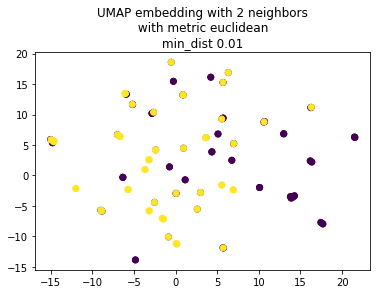

CPU times: user 3.01 s, sys: 111 ms, total: 3.12 s
Wall time: 3.19 s


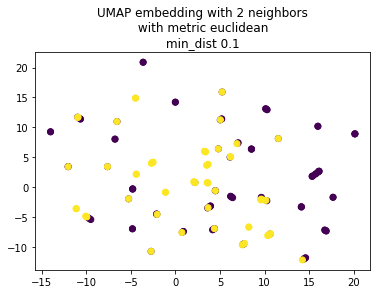

CPU times: user 2.99 s, sys: 112 ms, total: 3.1 s
Wall time: 3.13 s


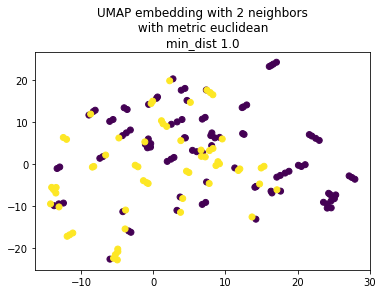

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

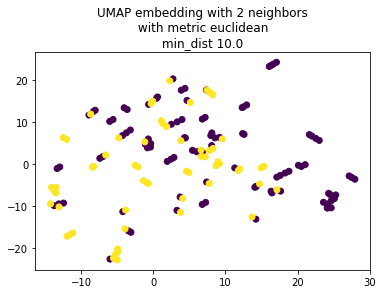

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

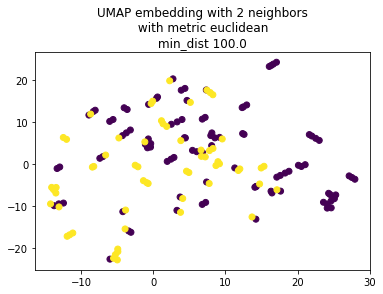

 12%|█████▋                                       | 1/8 [00:10<01:15, 10.83s/it]

CPU times: user 3.2 s, sys: 138 ms, total: 3.34 s
Wall time: 3.37 s


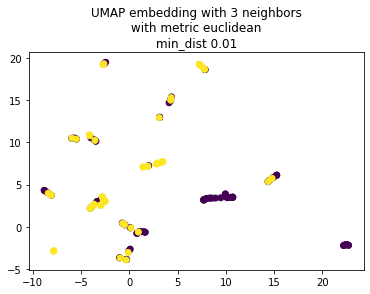

CPU times: user 2.85 s, sys: 101 ms, total: 2.95 s
Wall time: 2.94 s


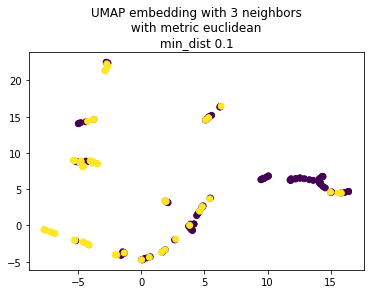

CPU times: user 3 s, sys: 112 ms, total: 3.11 s
Wall time: 3.05 s


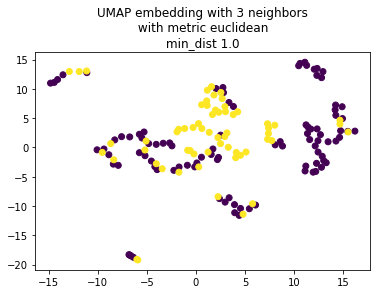

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

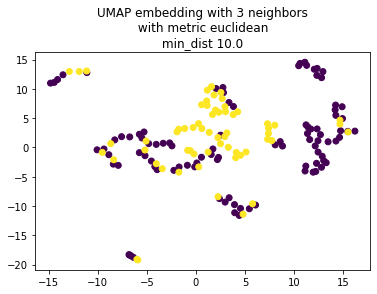

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

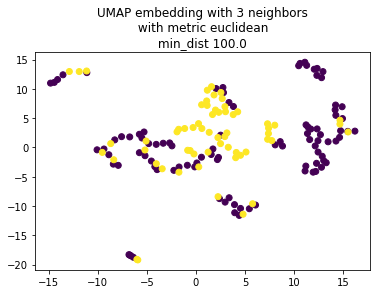

 25%|███████████▎                                 | 2/8 [00:21<01:04, 10.82s/it]

CPU times: user 2.98 s, sys: 104 ms, total: 3.08 s
Wall time: 3 s


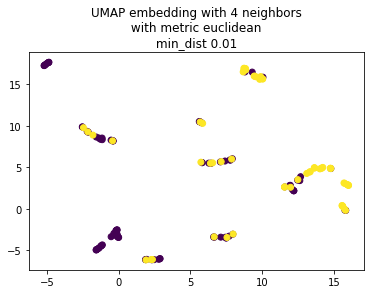

CPU times: user 2.95 s, sys: 101 ms, total: 3.06 s
Wall time: 2.91 s


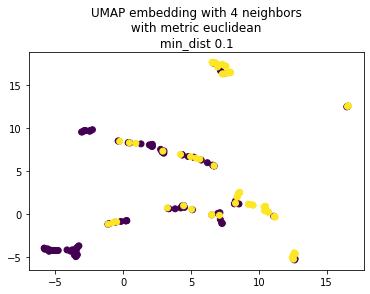

CPU times: user 2.94 s, sys: 98 ms, total: 3.04 s
Wall time: 2.89 s


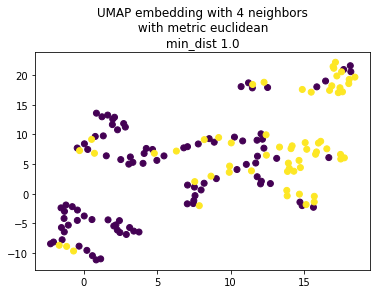

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

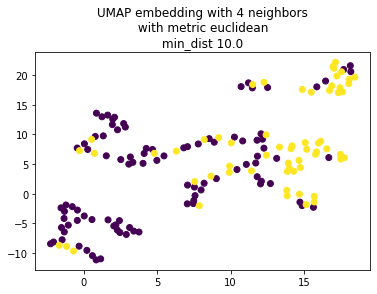

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

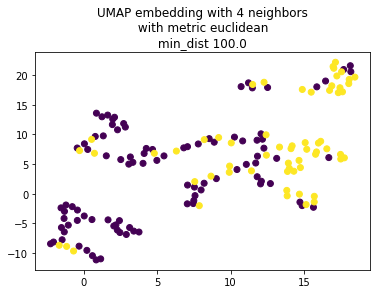

 38%|████████████████▉                            | 3/8 [00:31<00:52, 10.48s/it]

CPU times: user 3.26 s, sys: 109 ms, total: 3.37 s
Wall time: 3.21 s


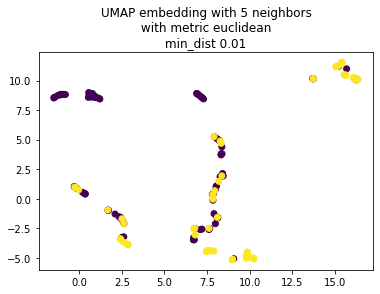

CPU times: user 2.93 s, sys: 103 ms, total: 3.04 s
Wall time: 2.89 s


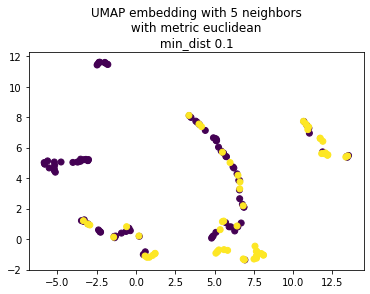

CPU times: user 2.99 s, sys: 109 ms, total: 3.1 s
Wall time: 2.98 s


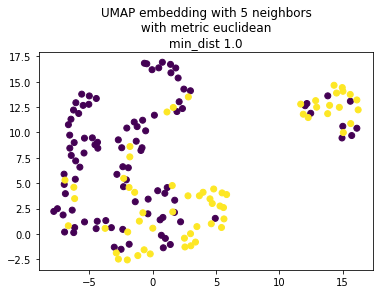

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

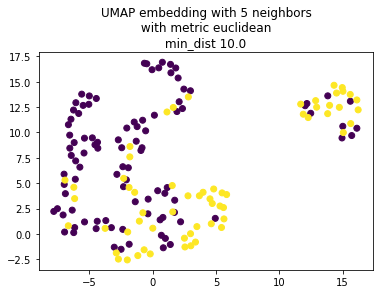

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

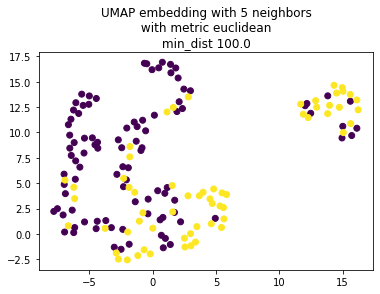

 50%|██████████████████████▌                      | 4/8 [00:42<00:42, 10.50s/it]

CPU times: user 3.27 s, sys: 108 ms, total: 3.38 s
Wall time: 3.06 s


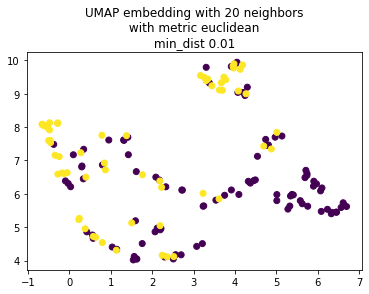

CPU times: user 3.18 s, sys: 101 ms, total: 3.29 s
Wall time: 3.08 s


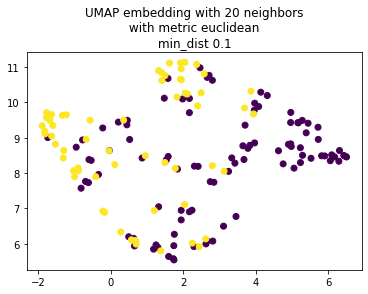

CPU times: user 3.03 s, sys: 88 ms, total: 3.11 s
Wall time: 2.7 s


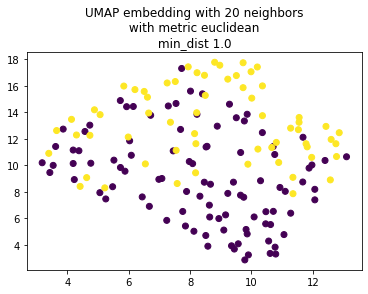

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

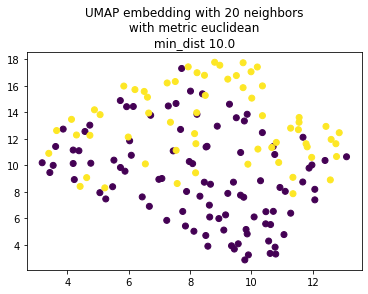

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

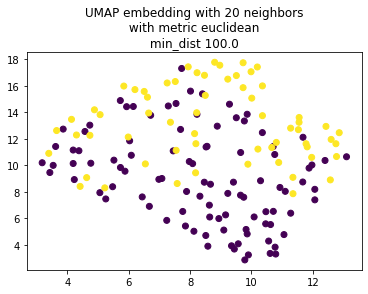

 62%|████████████████████████████▏                | 5/8 [00:52<00:31, 10.41s/it]

CPU times: user 3.37 s, sys: 112 ms, total: 3.48 s
Wall time: 3.03 s


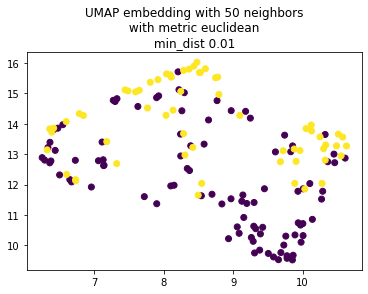

CPU times: user 3.55 s, sys: 118 ms, total: 3.67 s
Wall time: 3.28 s


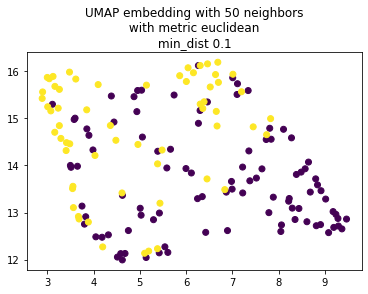

CPU times: user 3.19 s, sys: 94.4 ms, total: 3.28 s
Wall time: 2.73 s


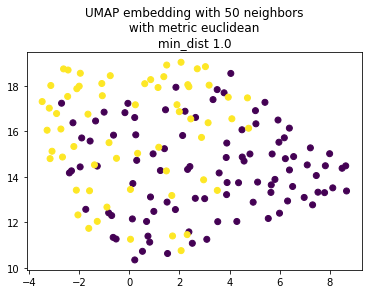

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

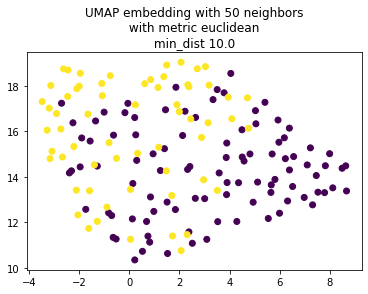

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

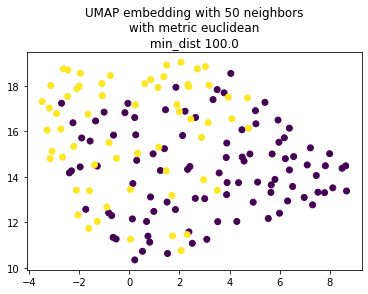

 75%|█████████████████████████████████▊           | 6/8 [01:03<00:21, 10.52s/it]

CPU times: user 3.58 s, sys: 111 ms, total: 3.69 s
Wall time: 3.09 s


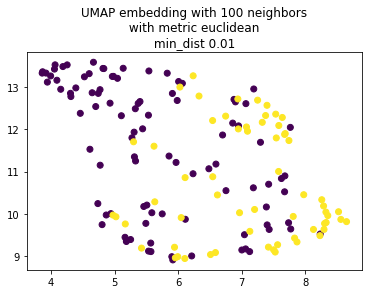

CPU times: user 3.56 s, sys: 111 ms, total: 3.67 s
Wall time: 3.12 s


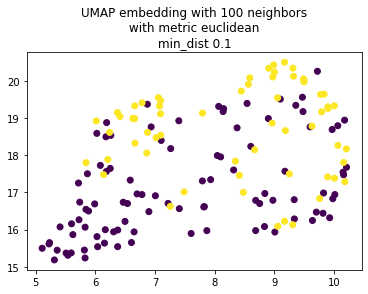

CPU times: user 4.11 s, sys: 126 ms, total: 4.24 s
Wall time: 3.74 s


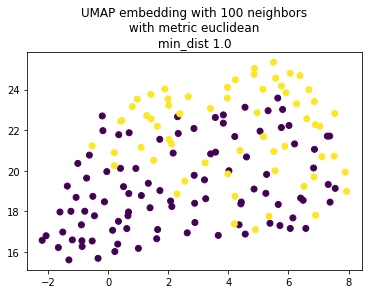

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

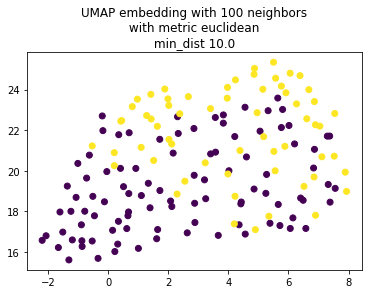

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

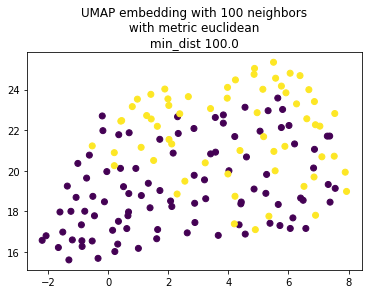

 88%|███████████████████████████████████████▍     | 7/8 [01:14<00:10, 10.67s/it]/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:2344: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  warn(


CPU times: user 3.59 s, sys: 109 ms, total: 3.7 s
Wall time: 3.15 s


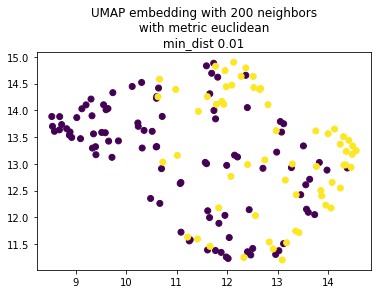

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:2344: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  warn(


CPU times: user 3.83 s, sys: 122 ms, total: 3.95 s
Wall time: 3.38 s


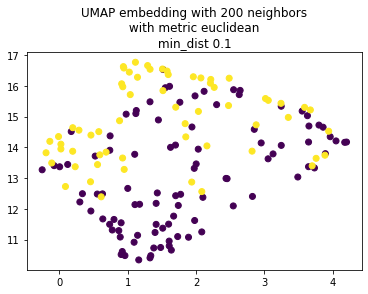

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:2344: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  warn(


CPU times: user 3.7 s, sys: 119 ms, total: 3.82 s
Wall time: 3.2 s


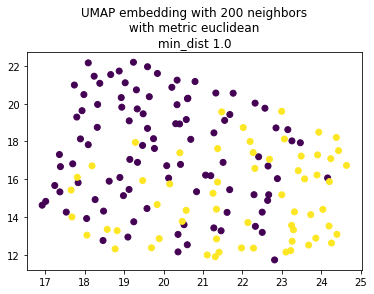

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

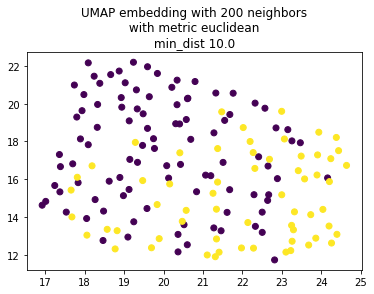

/opt/anaconda3/envs/jup/lib/python3.9/site-packages/umap/umap_.py:1356: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/opt/anaconda3/envs/jup/lib/python3.9/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


ValueError: min_dist must be less than or equal to spread

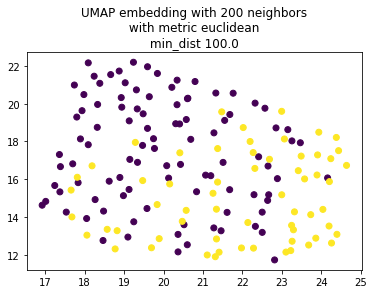

100%|█████████████████████████████████████████████| 8/8 [01:25<00:00, 10.66s/it]


In [14]:
from tqdm import tqdm 
data_ad={"clustering": [0.07692307692307693, 0.2857142857142857, 0.0, 0.08023809523809526, 0.23685714285714288, 0.0, 0.13409961685823757, 0.21937229437229436, 0.0, 0.09954648526077096, 0.14712301587301588, 0.09831349206349205, 0.13333333333333336, 0.05, 0.0, 0.16488095238095238, 0.0, 0.22727807172251618, 0.3, 0.0906746031746032, 0.04444444444444444, 0.3179673721340388, 0.1311111111111111, 0.09999999999999999, 0.10864197530864199, 0.33934213934213936, 0.06818181818181818, 0.06249999999999999, 0.0, 0.20717399884066545, 0.044241810199257, 0.1607553366174056, 0.08124999999999999, 0.28787878787878785, 0.27391577320583405, 0.1383333333333333, 0.0, 0.0840757808499744, 0.07152777777777777, 0.08617283950617283, 0.13823953823953825, 0.090625, 0.020512820512820513, 0.04838709677419355, 0.012913640032284098, 0.23809523809523808, 0.19047619047619047, 0.0, 0.0, 0.0, 0.125, 0.11848739495798319, 0.2783933080808081, 0.15247887033601318, 0.0, 0.25641025641025644, 0.3498563165229832, 0.14629629629629629, 0.1041847041847042, 0.11698043558508675, 0.1425249169435216], "diameter": [7.0, 4.0, 12.0, 11.0, 7.0, 6.0, 9.0, 6.0, 5.0, 10.0, 6.0, 7.0, 5.0, 5.0, 15.0, 8.0, 5.0, 6.0, 6.0, 17.0, 7.0, 7.0, 4.0, 9.0, 9.0, 7.0, 12.0, 10.0, 8.0, 7.0, 7.0, 6.0, 6.0, 8.0, 5.0, 5.0, 12.0, 6.0, 5.0, 16.0, 6.0, 9.0, 8.0, 11.0, 12.0, 10.0, 3.0, 8.0, 5.0, 11.0, 8.0, 16.0, 5.0, 5.0, 10.0, 5.0, 4.0, 6.0, 7.0, 6.0, 7.0], "number_of_nodes": [13.0, 14.0, 17.0, 50.0, 25.0, 12.0, 29.0, 22.0, 12.0, 56.0, 32.0, 40.0, 10.0, 22.0, 16.0, 32.0, 12.0, 27.0, 15.0, 60.0, 15.0, 36.0, 15.0, 39.0, 27.0, 39.0, 22.0, 32.0, 13.0, 36.0, 47.0, 29.0, 16.0, 11.0, 29.0, 20.0, 20.0, 31.0, 32.0, 45.0, 33.0, 32.0, 26.0, 31.0, 59.0, 14.0, 7.0, 18.0, 13.0, 12.0, 12.0, 34.0, 32.0, 28.0, 15.0, 13.0, 27.0, 18.0, 33.0, 43.0, 43.0], "subs": ["14003", "14021", "2017", "2087", "2095", "2201", "2297", "2330", "2366", "2390", "2445", "2567", "2595", "2652", "2667", "2677", "2679", "2722", "2728", "2766", "2767", "2792", "2821", "2864", "2868", "2886", "2896", "2987", "3008", "3023", "3029", "3035", "3045", "3053", "3071", "3092", "3127", "3130", "3149", "3163", "3187", "3194", "3207", "3213", "3242", "3277", "3326", "653", "654", "8004", "8046", "8052", "8063", "8126", "8130", "8140", "8141", "8144", "8151", "8163", "8176"], "density": [0.1794871794871795, 0.21978021978021978, 0.11764705882352941, 0.0563265306122449, 0.15, 0.21212121212121213, 0.10344827586206896, 0.17316017316017315, 0.18181818181818182, 0.05584415584415584, 0.11290322580645161, 0.09487179487179487, 0.2222222222222222, 0.17316017316017315, 0.125, 0.09274193548387097, 0.19696969696969696, 0.1452991452991453, 0.18095238095238095, 0.04971751412429379, 0.1619047619047619, 0.10952380952380952, 0.22857142857142856, 0.06747638326585695, 0.09971509971509972, 0.09176788124156546, 0.09956709956709957, 0.07661290322580645, 0.16666666666666666, 0.12222222222222222, 0.06567992599444958, 0.11576354679802955, 0.2, 0.23636363636363636, 0.18472906403940886, 0.14736842105263157, 0.1, 0.0989247311827957, 0.0967741935483871, 0.06868686868686869, 0.10984848484848485, 0.07862903225806452, 0.09538461538461539, 0.07741935483870968, 0.04266510812390415, 0.16483516483516483, 0.42857142857142855, 0.12418300653594772, 0.15384615384615385, 0.16666666666666666, 0.18181818181818182, 0.0677361853832442, 0.16330645161290322, 0.1402116402116402, 0.13333333333333333, 0.23076923076923078, 0.18803418803418803, 0.1437908496732026, 0.10227272727272728, 0.07751937984496124, 0.08084163898117387], "median_degree": [2.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.5, 1.0, 2.0, 2.5, 3.0, 2.0, 3.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 2.0, 4.0, 2.5, 2.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 2.0, 2.0, 4.5, 2.5, 2.0, 2.0, 4.0, 2.0, 3.0, 2.0, 3.0], "persev_data": [0.0, 0.17777777777777778, 0.15, 0.08305813553491573, 0.022222222222222223, 0.2932692307692308, 0.28286380286380286, 0.2111111111111111, 0.037037037037037035, 0.08673128342245989, 0.10925582354153782, 0.16307446055345215, 0.13392857142857142, 0.15645095645095644, 0.0, 0.10016025641025642, 0.19090909090909092, 0.17327647842353724, 0.17619047619047618, 0.11629809818664308, 0.07692307692307693, 0.08630341880341881, 0.2874493927125506, 0.09904970760233918, 0.22083333333333333, 0.06734539969834089, 0.0, 0.1661209161209161, 0.0, 0.23202793938088057, 0.13431188264779598, 0.04730392156862745, 0.1346153846153846, 0.0, 0.2255690737833595, 0.045454545454545456, 0.0, 0.12916666666666665, 0.08443223443223444, 0.19150326797385625, 0.13253458498023715, 0.014705882352941176, 0.059027777777777776, 0.052380952380952375, 0.011904761904761904, 0.125, 0.25, 0.07142857142857142, 0.0, 0.0, 0.125, 0.042328042328042326, 0.09560897435897436, 0.23547979797979796, 0.0625, 0.363961038961039, 0.3117237182185358, 0.10512820512820513, 0.11822916666666666, 0.04421768707482993, 0.13180272108843538], "mean_degree": [2.1538461538461537, 2.857142857142857, 1.8823529411764706, 2.76, 3.6, 2.3333333333333335, 2.896551724137931, 3.6363636363636362, 2.0, 3.0714285714285716, 3.5, 3.7, 2.0, 3.6363636363636362, 1.875, 2.875, 2.1666666666666665, 3.7777777777777777, 2.533333333333333, 2.933333333333333, 2.2666666666666666, 3.8333333333333335, 3.2, 2.5641025641025643, 2.5925925925925926, 3.4871794871794872, 2.090909090909091, 2.375, 2.0, 4.277777777777778, 3.021276595744681, 3.2413793103448274, 3.0, 2.3636363636363638, 5.172413793103448, 2.8, 1.9, 2.967741935483871, 3.0, 3.022222222222222, 3.515151515151515, 2.4375, 2.3846153846153846, 2.3225806451612905, 2.4745762711864407, 2.142857142857143, 2.5714285714285716, 2.111111111111111, 1.8461538461538463, 1.8333333333333333, 2.0, 2.235294117647059, 5.0625, 3.7857142857142856, 1.8666666666666667, 2.769230769230769, 4.888888888888889, 2.4444444444444446, 3.272727272727273, 3.255813953488372, 3.395348837209302], "numlists": [2.0, 3.0, 1.0, 9.0, 3.0, 2.0, 5.0, 6.0, 3.0, 8.0, 7.0, 7.0, 2.0, 6.0, 1.0, 8.0, 2.0, 8.0, 2.0, 7.0, 2.0, 10.0, 2.0, 6.0, 3.0, 5.0, 2.0, 6.0, 2.0, 9.0, 7.0, 6.0, 6.0, 1.0, 7.0, 4.0, 2.0, 6.0, 7.0, 5.0, 4.0, 4.0, 4.0, 4.0, 6.0, 1.0, 2.0, 2.0, 3.0, 1.0, 2.0, 6.0, 10.0, 8.0, 1.0, 4.0, 6.0, 2.0, 8.0, 7.0, 7.0], "persev_params": [0.0, 1.0, 0.02, 0.14, 0.03, 0.26, 0.84, 1.0, 0.05, 0.26, 0.31, 0.56, 0.16, 0.45, 0.0, 0.2, 0.16, 0.77, 0.15, 0.11, 0.09, 0.45, 1.0, 0.1, 0.16, 0.1, 0.0, 0.15, 0.0, 0.67, 0.24, 0.1, 0.12, 0.0, 1.0, 0.06, 0.0, 0.25, 0.26, 0.42, 0.86, 0.02, 0.06, 0.05, 0.02, 0.01, 0.36, 0.03, 0.0, 0.0, 0.08, 0.05, 0.25, 0.87, 0.01, 0.47, 0.94, 0.08, 0.33, 0.12, 0.29], "spl": [3.0, 2.241758241758242, 4.970588235294118, 4.169795918367347, 2.776666666666667, 2.590909090909091, 3.4926108374384235, 2.6233766233766236, 2.6363636363636362, 3.8487012987012985, 2.8004032258064515, 2.9833333333333334, 2.577777777777778, 2.3852813852813854, 5.666666666666667, 3.3891129032258065, 2.393939393939394, 2.6096866096866096, 2.8857142857142857, 5.444067796610169, 3.038095238095238, 2.846031746031746, 2.0952380952380953, 3.8110516934046346, 3.7834757834757835, 3.2550607287449393, 4.4978354978354975, 4.161290322580645, 3.358974358974359, 2.742857142857143, 3.2275670675300647, 2.8916256157635467, 2.4916666666666667, 3.4363636363636365, 2.1699507389162562, 2.9, 4.994736842105263, 2.9698924731182794, 2.8629032258064515, 5.268686868686869, 2.965909090909091, 3.8870967741935485, 3.7446153846153845, 4.232258064516129, 5.182933956750438, 4.274725274725275, 1.7142857142857142, 3.6013071895424837, 2.25, 4.333333333333333, 3.378787878787879, 5.374331550802139, 2.350806451612903, 2.4126984126984126, 4.380952380952381, 2.423076923076923, 2.133903133903134, 2.9411764705882355, 3.102272727272727, 3.0753045404208197, 3.1727574750830563], "smallworld": [0.5173721502874179, 1.5699013547107612, 0.0, 1.3432702597576216, 1.48859916013564, 0.0, 1.2171084144735351, 1.2113246551610766, 0.0, 1.6916676325440827, 1.3288272998080979, 1.0044905068146979, 0.8591193348846627, 0.30364756938745896, 0.0, 1.777077893621128, 0.0, 1.5434509727479337, 1.7933182278432351, 1.2961874563958067, 0.3203748233844747, 2.7981106806589486, 0.6829172461662436, 1.3397621145582306, 1.0345814804515354, 3.419618433957679, 0.6684012056690986, 0.8108098382675003, 0.0, 1.5672231200997584, 0.7425284926010829, 1.4241830599963174, 0.4389076546584051, 1.0868077022090097, 1.4501932892378002, 0.9913501632211905, 0.0, 0.9335010574681211, 0.8407130738252117, 0.8381975100477632, 1.2170683711117005, 1.1905810877033753, 0.22392285718358537, 0.6218488860299632, 0.26733804615213363, 1.2600603810726985, 0.6231886565049295, 0.0, 0.0, 0.0, 0.7957652187699428, 1.470148699807362, 1.59959061159865, 1.170021604276803, 0.0, 1.2509515456373042, 1.8804723774548826, 1.1844295968975709, 0.9986555608481857, 1.6007210453360878, 1.7504461872278037]}
data_nc= {"clustering": [0.0, 0.0, 0.16283181104609676, 0.08822087873812011, 0.14443768037518034, 0.1318786081296335, 0.12548083575480834, 0.1026666666666667, 0.11139122315592904, 0.12232365058452017, 0.10642551892551891, 0.020436507936507937, 0.16712247188437668, 0.12373737373737376, 0.18640890699714233, 0.06928300865800865, 0.07519841269841271, 0.04523809523809524, 0.11749890002902051, 0.0890952380952381, 0.05376344086021505, 0.015343915343915344, 0.15005692719978433, 0.22310643501119692, 0.048337825696316256, 0.18711493634570553, 0.09908103592314119, 0.17034785545423844, 0.14212454212454212, 0.1382045490741143, 0.009842325695984231, 0.16254578754578755, 0.18634510913922683, 0.030263387406244548, 0.06518620268620269, 0.1884421712546713, 0.120155981584553, 0.08767873540600814, 0.058888888888888886, 0.10423881673881673, 0.11636363636363636, 0.1342926019955059, 0.07882251082251082, 0.2732067007067007, 0.0634801799507682, 0.03958333333333334, 0.04791666666666667, 0.1984225034225034, 0.0, 0.1680861650426868, 0.12866522366522365, 0.11265734265734266, 0.10748299319727889, 0.07738759839600175, 0.14245187436676798, 0.1339306688143897, 0.178531613314222, 0.1362348588911089, 0.1457477565169873, 0.06759259259259259, 0.11609195402298851, 0.20257252326217845, 0.04249792760431058, 0.14503968253968255, 0.13939529305382967, 0.0, 0.11992562992562991, 0.10586781160551652, 0.10536715375425054, 0.08484848484848485, 0.059829059829059825, 0.11666666666666667, 0.0, 0.12037037037037036, 0.0, 0.0, 0.09229864785420341, 0.0, 0.06111317254174397, 0.12009839668067515, 0.10590468853180719, 0.14595569040013484, 0.11793650793650795, 0.10713997113997113, 0.19579300861052198, 0.1781058351370851, 0.17777845050572322, 0.04698258091115234, 0.24488807488807487, 0.09722222222222221, 0.05555555555555555, 0.08970162069335626, 0.07060090702947847, 0.09888888888888889, 0.22144792876500194, 0.038461538461538464, 0.17372193391463167], "diameter": [12.0, 9.0, 8.0, 9.0, 9.0, 11.0, 10.0, 7.0, 8.0, 11.0, 6.0, 9.0, 13.0, 7.0, 10.0, 17.0, 8.0, 11.0, 7.0, 16.0, 12.0, 10.0, 8.0, 5.0, 17.0, 11.0, 9.0, 6.0, 10.0, 15.0, 11.0, 12.0, 8.0, 12.0, 7.0, 9.0, 10.0, 8.0, 13.0, 6.0, 16.0, 9.0, 11.0, 7.0, 15.0, 9.0, 7.0, 8.0, 14.0, 10.0, 7.0, 12.0, 7.0, 10.0, 10.0, 8.0, 10.0, 10.0, 8.0, 8.0, 14.0, 7.0, 7.0, 7.0, 12.0, 9.0, 9.0, 10.0, 20.0, 13.0, 8.0, 18.0, 21.0, 6.0, 14.0, 21.0, 10.0, 11.0, 10.0, 12.0, 10.0, 6.0, 7.0, 5.0, 7.0, 8.0, 7.0, 9.0, 9.0, 7.0, 14.0, 14.0, 9.0, 8.0, 6.0, 9.0, 5.0], "number_of_nodes": [22.0, 23.0, 98.0, 58.0, 64.0, 159.0, 73.0, 25.0, 51.0, 69.0, 52.0, 40.0, 63.0, 44.0, 51.0, 80.0, 72.0, 60.0, 83.0, 100.0, 31.0, 66.0, 70.0, 63.0, 53.0, 65.0, 57.0, 47.0, 57.0, 92.0, 82.0, 52.0, 68.0, 91.0, 52.0, 96.0, 105.0, 66.0, 60.0, 48.0, 55.0, 79.0, 100.0, 60.0, 85.0, 32.0, 32.0, 60.0, 48.0, 115.0, 70.0, 65.0, 42.0, 119.0, 47.0, 86.0, 92.0, 64.0, 65.0, 36.0, 29.0, 58.0, 47.0, 48.0, 82.0, 27.0, 65.0, 61.0, 93.0, 55.0, 39.0, 20.0, 22.0, 18.0, 18.0, 22.0, 54.0, 26.0, 70.0, 79.0, 118.0, 54.0, 50.0, 50.0, 88.0, 64.0, 66.0, 84.0, 60.0, 24.0, 27.0, 121.0, 70.0, 30.0, 41.0, 26.0, 58.0], "subs": ["14003", "14021", "2004", "2007", "2011", "2015", "2016", "2032", "2053", "2060", "2080", "2086", "2090", "2093", "2099", "2115", "2146", "2157", "2172", "2294", "2366", "2367", "2408", "2423", "2444", "2447", "2449", "2452", "2456", "2461", "2462", "2481", "2491", "2495", "2501", "2544", "2558", "2559", "2566", "2568", "2570", "2573", "2575", "2579", "2583", "2589", "2595", "2598", "2603", "2608", "2611", "2621", "2628", "2634", "2636", "2645", "2650", "2656", "2663", "2664", "2667", "2670", "2679", "2728", "2754", "2767", "2820", "2821", "2824", "2894", "2896", "2951", "3008", "3127", "5", "6", "603", "6079", "610", "617", "618", "628", "641", "644", "647", "653", "654", "8011", "8027", "8046", "8052", "8094", "8130", "8141", "8144", "8145", "93"], "density": [0.1038961038961039, 0.10276679841897234, 0.046286555859457186, 0.05928614640048397, 0.06696428571428571, 0.02842130403630284, 0.05098934550989345, 0.12666666666666668, 0.06980392156862746, 0.051577152600170505, 0.08069381598793364, 0.06923076923076923, 0.05632360471070148, 0.07188160676532769, 0.08392156862745098, 0.0379746835443038, 0.041471048513302036, 0.04463276836158192, 0.0526006464883926, 0.028888888888888888, 0.07311827956989247, 0.04195804195804196, 0.05714285714285714, 0.08858166922683051, 0.04499274310595065, 0.05961538461538462, 0.05576441102756892, 0.0786308973172988, 0.05200501253132832, 0.033205924510272336, 0.03643480879253237, 0.05731523378582202, 0.06321334503950835, 0.0380952380952381, 0.06033182503770739, 0.04451754385964912, 0.03553113553113553, 0.05827505827505827, 0.04067796610169491, 0.07535460992907801, 0.04579124579124579, 0.06004543979227524, 0.032929292929292926, 0.07966101694915254, 0.037815126050420166, 0.07459677419354839, 0.09274193548387097, 0.07457627118644068, 0.04609929078014184, 0.03646071700991609, 0.0567287784679089, 0.058653846153846154, 0.08362369337979095, 0.031476997578692496, 0.0666049953746531, 0.046785225718194254, 0.04228380315336837, 0.06646825396825397, 0.06201923076923077, 0.0873015873015873, 0.0812807881773399, 0.05868118572292801, 0.07215541165587419, 0.06826241134751773, 0.04938271604938271, 0.08547008547008547, 0.06009615384615385, 0.05792349726775956, 0.033660589060308554, 0.041750841750841754, 0.06612685560053981, 0.10526315789473684, 0.09090909090909091, 0.13725490196078433, 0.1111111111111111, 0.09090909090909091, 0.061495457721872815, 0.08615384615384615, 0.047619047619047616, 0.04771178188899708, 0.030856149500217298, 0.07617051013277429, 0.07755102040816327, 0.0783673469387755, 0.06269592476489028, 0.06398809523809523, 0.07179487179487179, 0.03843947217441193, 0.07570621468926554, 0.10869565217391304, 0.08262108262108261, 0.03016528925619835, 0.04803312629399586, 0.09885057471264368, 0.11829268292682926, 0.09230769230769231, 0.08711433756805807], "median_degree": [2.0, 2.0, 3.0, 2.5, 2.5, 3.0, 3.0, 2.0, 3.0, 2.0, 4.0, 2.0, 2.0, 3.0, 3.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 3.0, 5.0, 2.0, 3.0, 2.0, 3.0, 2.0, 2.0, 2.0, 2.5, 2.0, 2.0, 2.0, 3.0, 2.0, 3.0, 2.0, 3.0, 2.0, 3.0, 2.0, 3.0, 2.0, 2.0, 2.5, 4.0, 2.0, 3.0, 2.5, 4.0, 3.0, 2.0, 3.0, 4.0, 2.5, 2.5, 2.0, 3.0, 2.0, 2.0, 2.0, 3.0, 3.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 3.0, 2.0, 2.0, 2.0, 2.0, 3.0, 4.0, 2.5, 4.0, 3.0, 3.0, 2.0, 4.0, 2.0, 2.0, 2.0, 2.0, 2.5, 4.0, 2.0, 3.5], "persev_data": [0.03125, 0.09453781512605042, 0.023359706201321107, 0.03900850611376927, 0.013928571428571429, 0.027056020887178314, 0.013528138528138528, 0.068218954248366, 0.015455304928989139, 0.033113553113553115, 0.016369047619047616, 0.03333333333333333, 0.054839750892382466, 0.026988636363636364, 0.03824189608503334, 0.013636363636363637, 0.0, 0.020869565217391306, 0.03676712779973649, 0.023835701197020536, 0.0, 0.016606280193236716, 0.03882056196297683, 0.030175725375000736, 0.03390293916609706, 0.005952380952380952, 0.006666666666666667, 0.016281512605042014, 0.00909090909090909, 0.01719298245614035, 0.03363167752308024, 0.04632528180354267, 0.08260233918128655, 0.01001602564102564, 0.02708333333333333, 0.032140702107257293, 0.02340267183659632, 0.020847362514029178, 0.017543859649122806, 0.03151515151515152, 0.026625704045058884, 0.04448784298408359, 0.016657870877819725, 0.09749891819869967, 0.018551056786350904, 0.021739130434782608, 0.06818181818181818, 0.017205932940771766, 0.05, 0.03848764049913475, 0.013636363636363636, 0.033134920634920635, 0.0, 0.012351190476190476, 0.030994152046783626, 0.0085548354779124, 0.04326528607421057, 0.02297794117647059, 0.07723119351408825, 0.028985507246376812, 0.029411764705882353, 0.033628207541251016, 0.06395989974937343, 0.06335152261925717, 0.03618796662274923, 0.025641025641025644, 0.08209510564583028, 0.028442317916002127, 0.021466861598440544, 0.010526315789473684, 0.017857142857142856, 0.0, 0.0, 0.1, 0.05263157894736842, 0.0, 0.015546218487394958, 0.0, 0.016514161220043573, 0.011532372146182886, 0.0137016750019846, 0.02001488095238095, 0.025967697020328598, 0.04249817251461988, 0.02749772372450391, 0.06217499500859755, 0.04964502817443993, 0.041359620771385476, 0.10199028581684391, 0.09215686274509804, 0.02631578947368421, 0.026747440593594442, 0.05810457516339869, 0.07342995169082125, 0.08544117647058824, 0.0, 0.02109328579916815], "mean_degree": [2.1818181818181817, 2.260869565217391, 4.489795918367347, 3.3793103448275863, 4.21875, 4.490566037735849, 3.671232876712329, 3.04, 3.4901960784313726, 3.5072463768115942, 4.115384615384615, 2.7, 3.492063492063492, 3.090909090909091, 4.196078431372549, 3.0, 2.9444444444444446, 2.6333333333333333, 4.313253012048193, 2.86, 2.193548387096774, 2.727272727272727, 3.942857142857143, 5.492063492063492, 2.339622641509434, 3.8153846153846156, 3.1228070175438596, 3.617021276595745, 2.912280701754386, 3.0217391304347827, 2.951219512195122, 2.923076923076923, 4.235294117647059, 3.4285714285714284, 3.076923076923077, 4.229166666666667, 3.6952380952380954, 3.787878787878788, 2.4, 3.5416666666666665, 2.4727272727272727, 4.6835443037974684, 3.26, 4.7, 3.176470588235294, 2.3125, 2.875, 4.4, 2.1666666666666665, 4.156521739130435, 3.914285714285714, 3.753846153846154, 3.4285714285714284, 3.7142857142857144, 3.0638297872340425, 3.9767441860465116, 3.847826086956522, 4.1875, 3.9692307692307693, 3.0555555555555554, 2.2758620689655173, 3.3448275862068964, 3.3191489361702127, 3.2083333333333335, 4.0, 2.2222222222222223, 3.8461538461538463, 3.4754098360655736, 3.096774193548387, 2.2545454545454544, 2.5128205128205128, 2.0, 1.9090909090909092, 2.3333333333333335, 1.8888888888888888, 1.9090909090909092, 3.259259259259259, 2.1538461538461537, 3.2857142857142856, 3.721518987341772, 3.610169491525424, 4.037037037037037, 3.8, 3.84, 5.454545454545454, 4.03125, 4.666666666666667, 3.1904761904761907, 4.466666666666667, 2.5, 2.1481481481481484, 3.6198347107438016, 3.3142857142857145, 2.8666666666666667, 4.7317073170731705, 2.3076923076923075, 4.9655172413793105], "numlists": [2.0, 2.0, 14.0, 6.0, 10.0, 19.0, 11.0, 3.0, 7.0, 15.0, 8.0, 5.0, 6.0, 4.0, 9.0, 7.0, 5.0, 4.0, 12.0, 7.0, 2.0, 9.0, 13.0, 12.0, 5.0, 14.0, 6.0, 8.0, 10.0, 10.0, 13.0, 5.0, 12.0, 8.0, 10.0, 13.0, 12.0, 12.0, 6.0, 10.0, 3.0, 14.0, 9.0, 17.0, 11.0, 2.0, 5.0, 17.0, 4.0, 12.0, 10.0, 8.0, 7.0, 16.0, 6.0, 13.0, 12.0, 16.0, 12.0, 3.0, 2.0, 7.0, 5.0, 5.0, 11.0, 3.0, 9.0, 7.0, 10.0, 5.0, 4.0, 1.0, 1.0, 2.0, 1.0, 1.0, 7.0, 2.0, 15.0, 13.0, 13.0, 8.0, 6.0, 8.0, 26.0, 9.0, 20.0, 17.0, 10.0, 3.0, 2.0, 13.0, 10.0, 3.0, 6.0, 2.0, 11.0], "persev_params": [0.02, 0.05, 0.1, 0.09, 0.03, 0.07, 0.02, 0.09, 0.04, 0.04, 0.04, 0.06, 0.07, 0.03, 0.08, 0.01, 0.0, 0.02, 0.11, 0.03, 0.0, 0.03, 0.1, 0.08, 0.02, 0.01, 0.01, 0.03, 0.01, 0.02, 0.0, 0.06, 0.16, 0.02, 0.0, 0.09, 0.07, 0.04, 0.02, 0.06, 0.02, 0.13, 0.02, 0.25, 0.03, 0.01, 0.1, 0.04, 0.01, 0.13, 0.03, 0.07, 0.0, 0.04, 0.06, 0.01, 0.09, 0.05, 0.16, 0.06, 0.01, 0.07, 0.21, 0.1, 0.1, 0.03, 0.41, 0.06, 0.03, 0.01, 0.02, 0.0, 0.0, 0.09, 0.01, 0.0, 0.02, 0.0, 0.0, 0.04, 0.02, 0.04, 0.07, 0.08, 0.07, 0.19, 0.14, 0.0, 0.45, 0.15, 0.01, 0.05, 0.14, 0.07, 0.25, 0.0, 0.08], "spl": [4.536796536796537, 3.8735177865612647, 3.2577319587628866, 3.768905021173624, 3.2222222222222223, 3.7482684499641747, 3.6274733637747336, 3.03, 3.256470588235294, 3.9092071611253196, 2.944193061840121, 3.673076923076923, 4.298515104966718, 3.429175475687104, 3.4211764705882355, 5.1835443037974684, 4.118153364632238, 4.581920903954802, 3.0861004995592123, 5.221818181818182, 5.008602150537635, 4.117016317016317, 3.2803312629399586, 2.5698924731182795, 5.856313497822931, 3.608173076923077, 3.9724310776942358, 3.115633672525439, 4.057017543859649, 4.751552795031056, 4.045769346582355, 4.3710407239819, 3.2151009657594383, 4.055921855921856, 3.368024132730015, 3.5032894736842106, 3.9108058608058607, 3.4941724941724943, 5.425423728813559, 3.148936170212766, 5.573063973063973, 3.234988640051931, 4.4228282828282826, 2.863276836158192, 4.5739495798319325, 4.050403225806452, 3.2963709677419355, 3.0327683615819208, 5.875, 3.7588100686498858, 3.202070393374741, 3.6533653846153844, 3.1823461091753775, 3.9213787209799174, 3.806660499537465, 3.5991792065663475, 3.6275680840898232, 3.3938492063492065, 3.4620192307692306, 3.4015873015873015, 5.593596059113301, 3.5063520871143377, 3.181313598519889, 3.37322695035461, 3.661547726588377, 3.9572649572649574, 3.4610576923076923, 3.7775956284153005, 5.620617110799439, 5.888888888888889, 3.9055330634278005, 6.905263157894737, 7.666666666666667, 3.0588235294117645, 5.450980392156863, 7.666666666666667, 3.710691823899371, 4.581538461538462, 3.9180124223602486, 3.810775722168127, 3.899029407503984, 2.9615653389238297, 3.119183673469388, 2.889795918367347, 2.9367816091954024, 3.1140873015873014, 2.935198135198135, 3.668387837062536, 3.2824858757062145, 3.510869565217391, 5.2079772079772075, 4.3615702479338845, 3.7681159420289854, 3.3563218390804597, 2.6134146341463413, 4.258461538461538, 2.692679975801573], "smallworld": [0.0, 0.0, 3.3307761271373595, 1.3396746115604656, 1.9646016940114386, 4.204264170417766, 2.2691768510754615, 0.8066931061137176, 1.5722551301377707, 2.0772129694860335, 1.2756512410000644, 0.30613149074697077, 2.32392798049922, 1.7225122955060086, 1.8155880641502813, 1.4216713673915948, 1.7682716673413459, 0.951259063880584, 2.214875137364607, 2.6144683959301545, 0.6631719425928576, 0.37663049564426354, 2.5149898910802655, 2.4223618695860902, 0.8733767950457376, 2.754195948344517, 1.6164098653265, 2.127607041621125, 2.593350095991807, 3.621083390930692, 0.2752386307932721, 2.4368853129979864, 2.7202444000466737, 0.7250268592679361, 1.1499043321260018, 3.864831093072144, 3.1085521185012794, 1.3754189704284094, 1.2690637890937997, 1.3733859423160069, 2.0557118962724323, 1.9815066703112267, 2.1303994475952477, 3.2226829957411627, 1.4275502521255914, 0.5590661751175574, 0.5309731154103222, 2.4654848917644685, 0.0, 4.120619124219424, 2.2371501398109794, 1.6850317333084808, 1.2550701068542711, 2.3028039147943202, 1.9739959262046491, 2.5966088225300745, 3.948669105393606, 1.7816526697666144, 2.0875774383659564, 0.751106166991679, 1.0828865260643563, 3.368961677379984, 0.6070634218215859, 2.136204071348883, 2.480831094491246, 0.0, 1.814643307403887, 1.6232620593858103, 2.2574848418050384, 1.732634300800059, 0.9453389334606184, 0.7302038066819349, 0.0, 1.0355676848352646, 0.0, 0.0, 1.3913740386382758, 0.0, 1.1867992483220116, 2.2244275740373745, 3.2992235653790227, 1.8843421780102971, 1.457852246426889, 1.4036206507777307, 2.838758965983482, 2.7088048050753044, 2.3297583415003436, 1.2877972639625386, 2.7415666983410203, 0.9220405836103771, 0.5779441581187199, 2.5628822192772898, 1.4030872223307373, 0.9957942077366074, 1.754244739475192, 0.39645893697852647, 1.9094314032334467]}
df1=pd.DataFrame(data_nc)
df1['diagnosis']='NC'
df2=pd.DataFrame(data_ad)
df2['diagnosis']='AD'
df=pd.concat([df1,df2],ignore_index=True)
df3=pd.DataFrame({'persev_data':df['persev_data'],'diameter': df['diameter'],'mean_degree': df['mean_degree'],'numlists': df['numlists']})
for n in tqdm((2,3,4, 5, 20, 50, 100, 200)):
    for p in (1e-2,1e-1,1e0,1e1,1e2):
        metric='euclidean'
        fit = umap.UMAP(n_neighbors=n,metric=metric,min_dist=p)
        %time u = fit.fit_transform(df3.to_numpy())
        plt.scatter(u[:,0], u[:,1],c=df['diagnosis']=='AD')
        plt.title(f'UMAP embedding with {n} neighbors\n with metric {metric} \n mininum distance: {p} ')
        plt.show()

### Trying all visualizations beyond the default layout in Networkx

Here I'm trying it for the first six NC patients. 

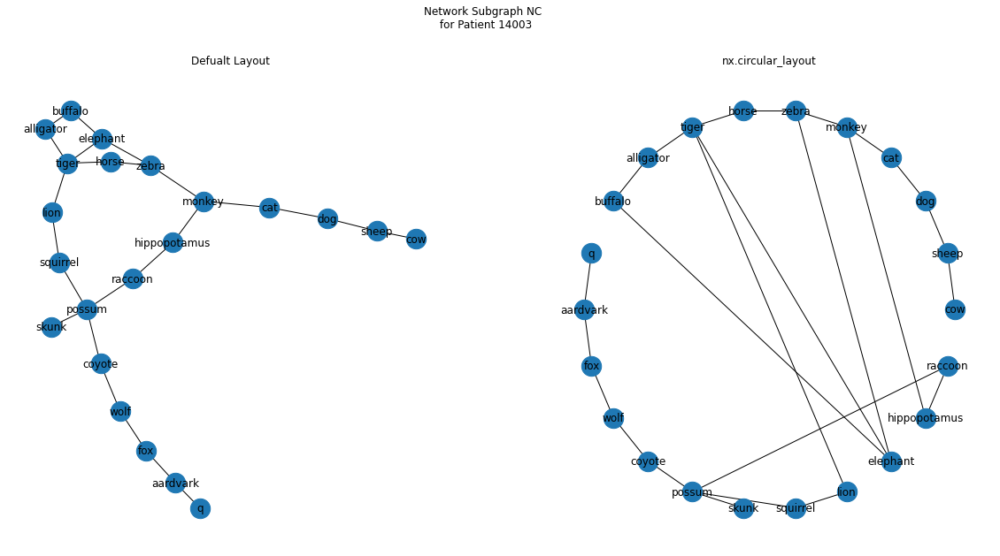

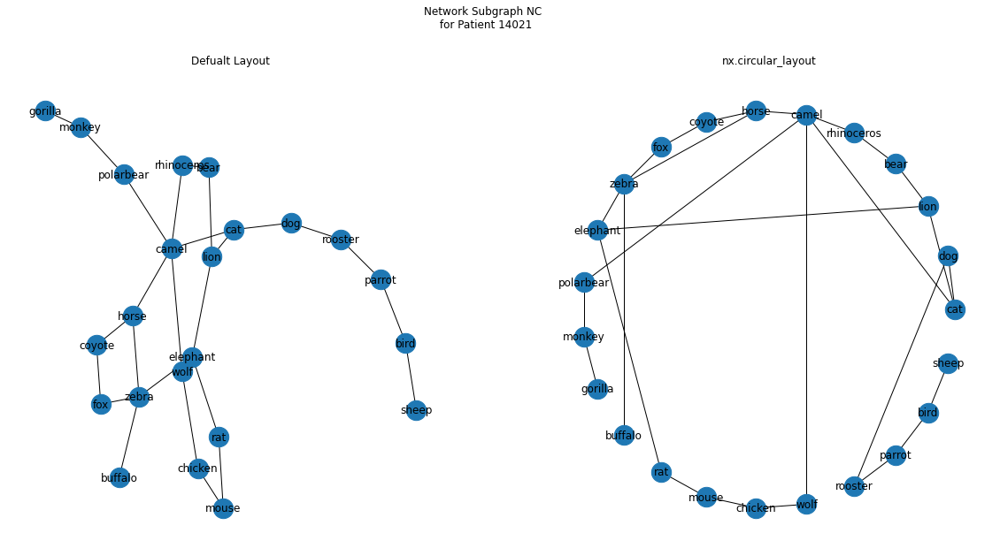

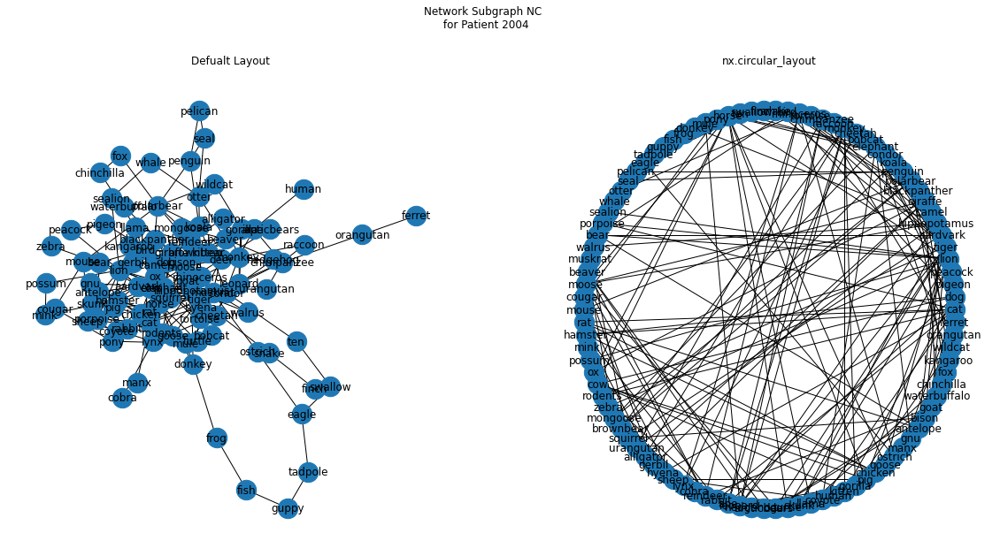

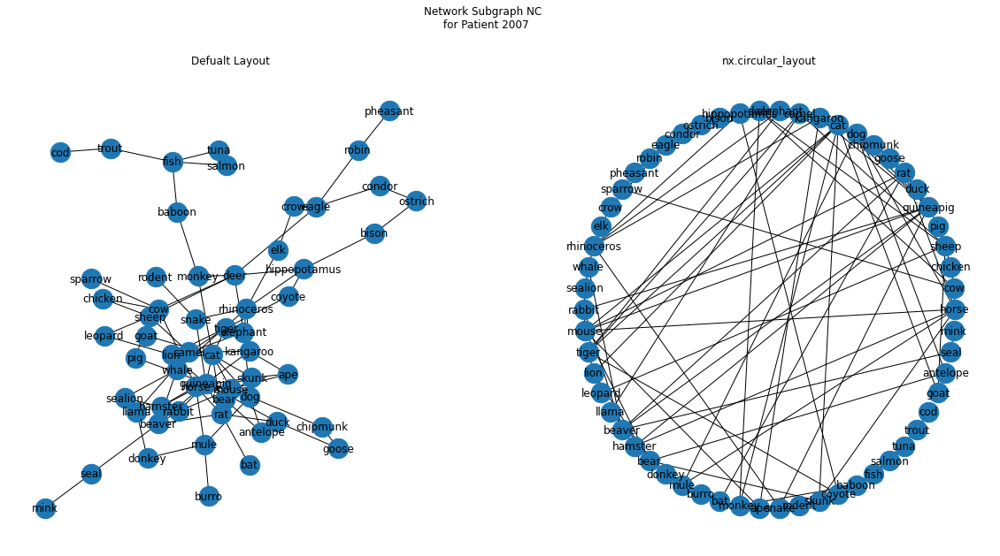

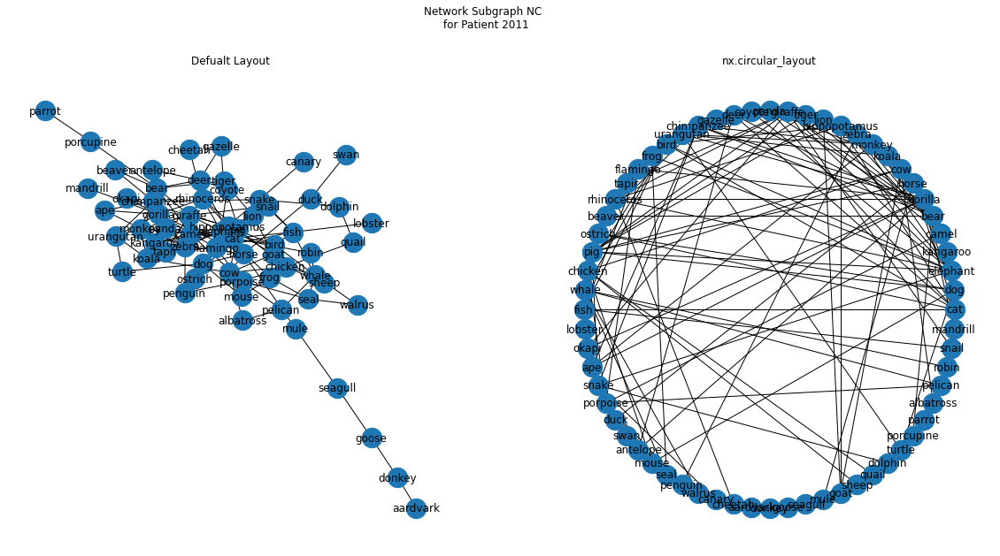

...

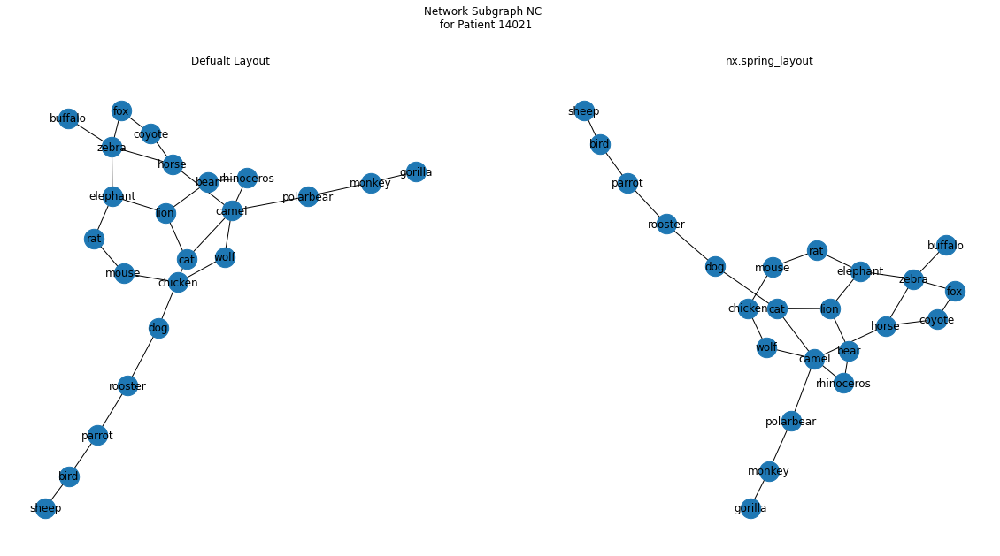

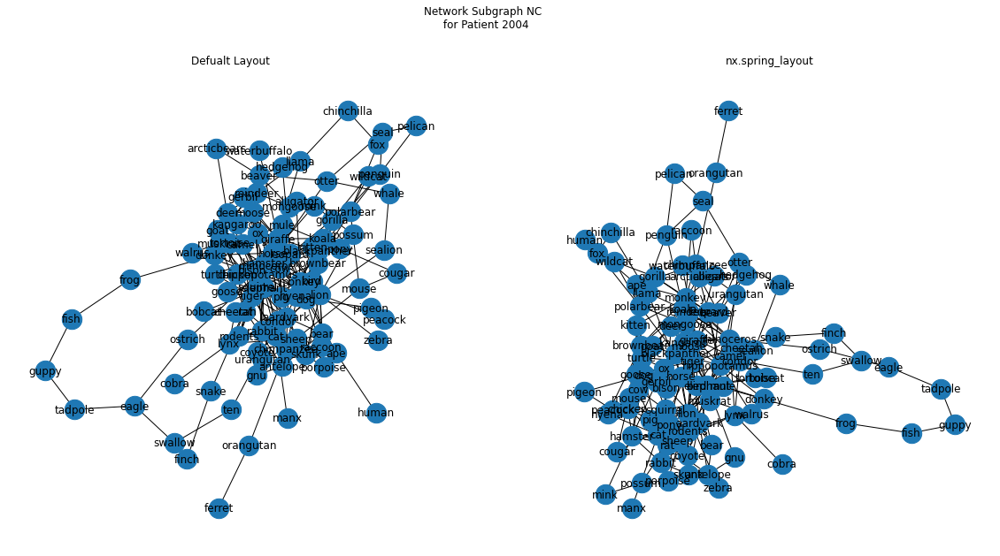

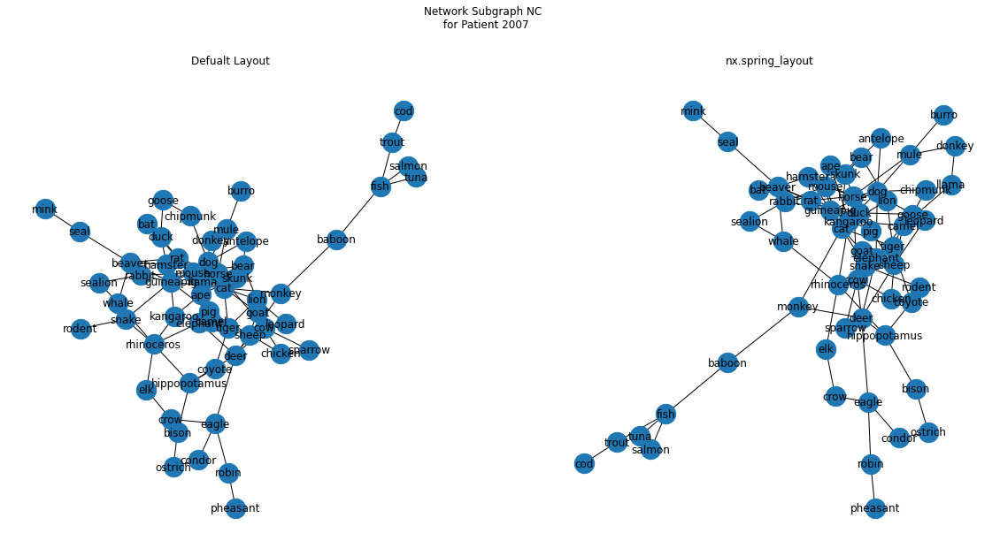

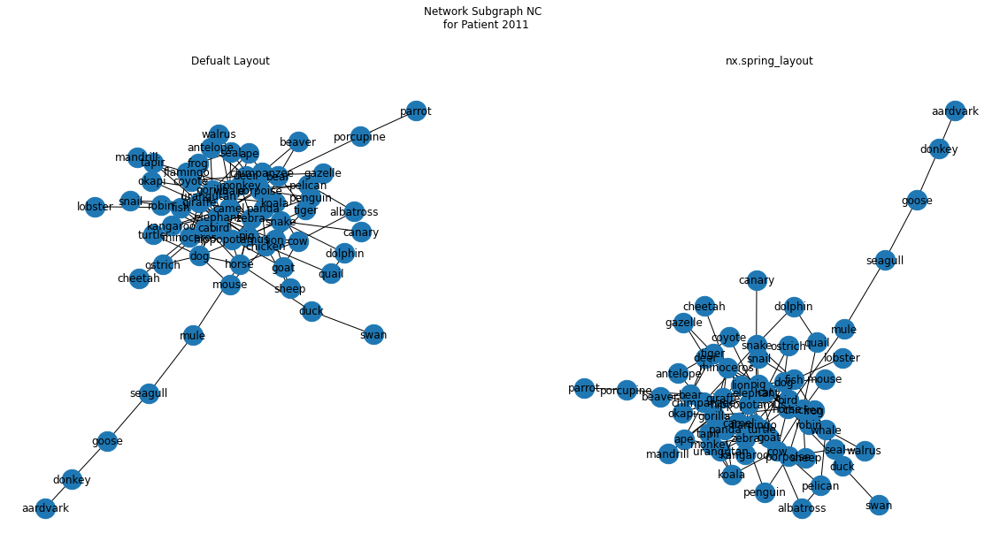

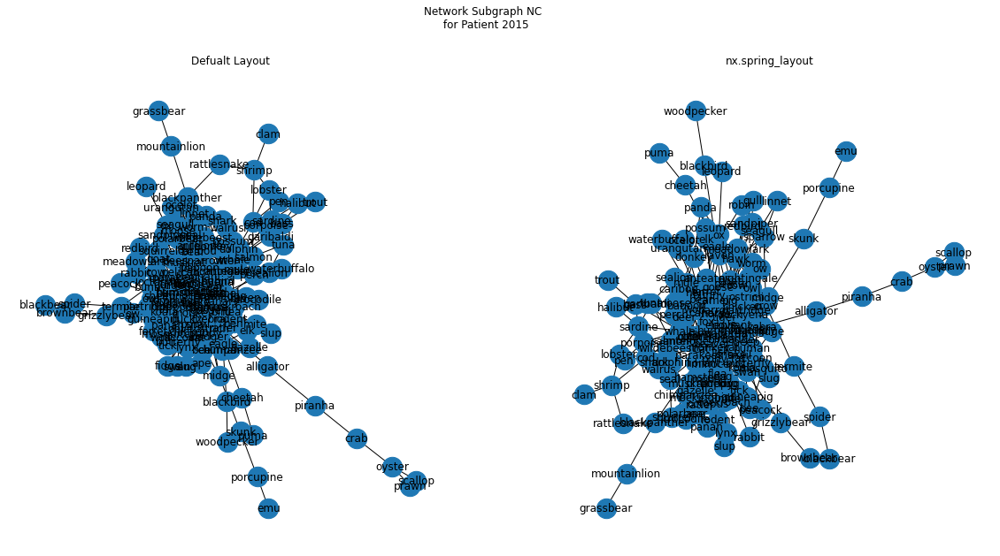

In [16]:
def visualize_all_graphs2(df,layout_func:str):
    for row in df.itertuples(): 
        fig, (ax1,ax2) = plt.subplots(1, 2,figsize=(20, 10))
        fig.suptitle(f'Network Subgraph {row.diagnosis} \n for Patient {row.subs}')
        G=nx.from_numpy_matrix(row.subgraphs)
        nx.draw(G,with_labels=True,labels=row.items,node_size=500,font_size=12,ax=ax1)
        ax1.set_title('Defualt Layout')
#         plt.show()
        nx.draw(G, pos=eval(layout_func)(G),with_labels=True,labels=row.items,node_size=500,font_size=12,ax=ax2)
        ax2.set_title(f'{layout_func}')
        plt.show()
#         plt.title(f'network subgraph {i} \n for patient {df.iloc[i]["subs"]} \n spring layout ')
#         plt.show()

## code to find all possible graph layout metrics. 
layouts= [method_name for method_name in dir(nx.drawing.layout)
                  if callable(getattr(nx.drawing.layout, method_name)) and '_layout' in method_name]

layouts.remove('bipartite_layout')
layouts.remove('multipartite_layout')
layouts.remove('planar_layout')
layouts.remove('rescale_layout')
layouts.remove('rescale_layout_dict')
for layout in layouts: 
    visualize_all_graphs2(df_nc[:6],'nx.'+layout)